#### 1.1 Read the data and do exploratory data analysis. Describe the data briefly. (Check the Data types, shape, EDA, 5 point summary). Perform Univariate, Bivariate Analysis, Multivariate Analysis. - 8 marks

In [1]:
import seaborn as sns
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.model_selection import train_test_split
import statsmodels.api as sm
from sklearn.preprocessing import StandardScaler

In [2]:
df=pd.read_excel('compactiv.xlsx')
df.head()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgscan,atch,pgin,ppgin,pflt,vflt,runqsz,freemem,freeswap,usr
0,1,0,2147,79,68,0.2,0.2,40671.0,53995.0,0.0,...,0.0,0.0,1.6,2.6,16.00,26.40,CPU_Bound,4670,1730946,95
1,0,0,170,18,21,0.2,0.2,448.0,8385.0,0.0,...,0.0,0.0,0.0,0.0,15.63,16.83,Not_CPU_Bound,7278,1869002,97
2,15,3,2162,159,119,2.0,2.4,NaN,31950.0,0.0,...,0.0,1.2,6.0,9.4,150.20,220.20,Not_CPU_Bound,702,1021237,87
3,0,0,160,12,16,0.2,0.2,NaN,8670.0,0.0,...,0.0,0.0,0.2,0.2,15.60,16.80,Not_CPU_Bound,7248,1863704,98
4,5,1,330,39,38,0.4,0.4,NaN,12185.0,0.0,...,0.0,0.0,1.0,1.2,37.80,47.60,Not_CPU_Bound,633,1760253,90


In [3]:
df.shape

(8192, 22)

In [4]:
df.isnull().sum()

lread         0
lwrite        0
scall         0
sread         0
swrite        0
fork          0
exec          0
rchar       104
wchar        15
pgout         0
ppgout        0
pgfree        0
pgscan        0
atch          0
pgin          0
ppgin         0
pflt          0
vflt          0
runqsz        0
freemem       0
freeswap      0
usr           0
dtype: int64

In [5]:
df.duplicated().sum()

0

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8192 entries, 0 to 8191
Data columns (total 22 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   lread     8192 non-null   int64  
 1   lwrite    8192 non-null   int64  
 2   scall     8192 non-null   int64  
 3   sread     8192 non-null   int64  
 4   swrite    8192 non-null   int64  
 5   fork      8192 non-null   float64
 6   exec      8192 non-null   float64
 7   rchar     8088 non-null   float64
 8   wchar     8177 non-null   float64
 9   pgout     8192 non-null   float64
 10  ppgout    8192 non-null   float64
 11  pgfree    8192 non-null   float64
 12  pgscan    8192 non-null   float64
 13  atch      8192 non-null   float64
 14  pgin      8192 non-null   float64
 15  ppgin     8192 non-null   float64
 16  pflt      8192 non-null   float64
 17  vflt      8192 non-null   float64
 18  runqsz    8192 non-null   object 
 19  freemem   8192 non-null   int64  
 20  freeswap  8192 non-null   int6

In [7]:
df.describe().T

### FIVE POINT SUMMARY

,count,mean,std,min,25%,50%,75%,max
lread,8192.0,1.955969e+01,53.353799,0.0,2.0,7.0,20.000,1845.00
lwrite,8192.0,1.310620e+01,29.891726,0.0,0.0,1.0,10.000,575.00
scall,8192.0,2.306318e+03,1633.617322,109.0,1012.0,2051.5,3317.250,12493.00
sread,8192.0,2.104800e+02,198.980146,6.0,86.0,166.0,279.000,5318.00
swrite,8192.0,1.500582e+02,160.478980,7.0,63.0,117.0,185.000,5456.00
fork,8192.0,1.884554e+00,2.479493,0.0,0.4,0.8,2.200,20.12
exec,8192.0,2.791998e+00,5.212456,0.0,0.2,1.2,2.800,59.56
rchar,8088.0,1.973857e+05,239837.493526,278.0,34091.5,125473.5,267828.750,2526649.00
wchar,8177.0,9.590299e+04,140841.707911,1498.0,22916.0,46619.0,106101.000,1801623.00
pgout,8192.0,2.285317e+00,5.307038,0.0,0.0,0.0,2.400,81.44


In [8]:
df.rchar.unique()

array([ 40671.,    448.,     nan, ..., 325948.,  62571., 111111.])

In [9]:
df.wchar.unique()

array([53995.,  8385., 31950., ..., 85282., 29505., 22256.])

In [10]:
### treating null values
df.rchar.fillna(df.rchar.median(),inplace=True)
df.wchar.fillna(df.wchar.median(),inplace=True)

In [11]:
### null values treated
df.isnull().sum()

lread       0
lwrite      0
scall       0
sread       0
swrite      0
fork        0
exec        0
rchar       0
wchar       0
pgout       0
ppgout      0
pgfree      0
pgscan      0
atch        0
pgin        0
ppgin       0
pflt        0
vflt        0
runqsz      0
freemem     0
freeswap    0
usr         0
dtype: int64

In [12]:
df.runqsz.value_counts()

Not_CPU_Bound    4331
CPU_Bound        3861
Name: runqsz, dtype: int64

In [13]:
df['runqsz'].replace('Not_CPU_Bound',0,inplace=True)

In [14]:
df['runqsz'].replace('CPU_Bound',1,inplace=True)

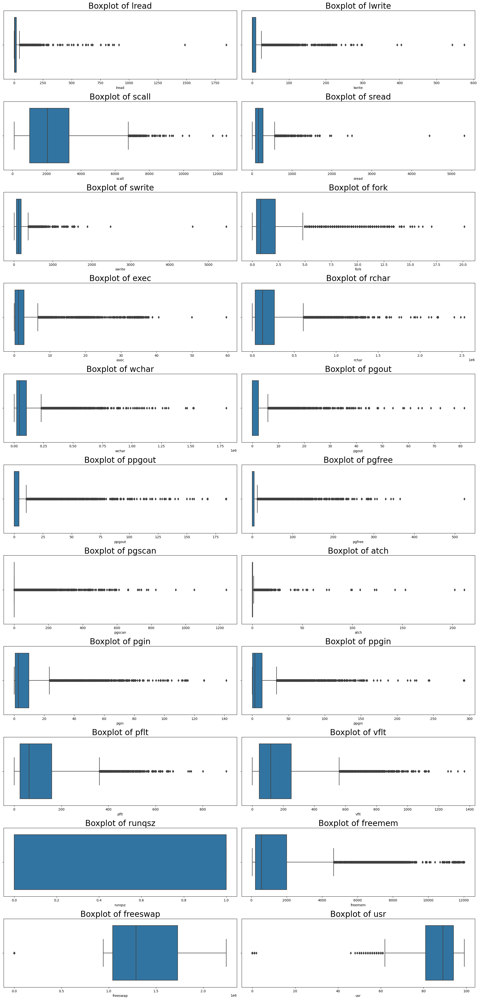

In [15]:
plt.figure(figsize=(20,60))
features=df.columns
for f in range(0,len(features)):
    plt.subplot(16,2,f+1)
    sns.boxplot(data=df,x=df.columns[f])
    plt.title(f"Boxplot of {df.columns[f]}",fontsize=24)
    plt.tight_layout();

In [16]:
def remove_outlier(col):
    Q1,Q3=col.quantile([0.25,0.75])
    IQR=Q3-Q1
    upperrange=Q3+(1.5*IQR)
    lowerrange=Q1-(1.5*IQR)
    return upperrange,lowerrange

In [17]:
for i in features:
    ur,lr=remove_outlier(df[i])
    df[i]=np.where(df[i]>ur,ur,df[i])
    df[i]=np.where(df[i]<lr,lr,df[i])

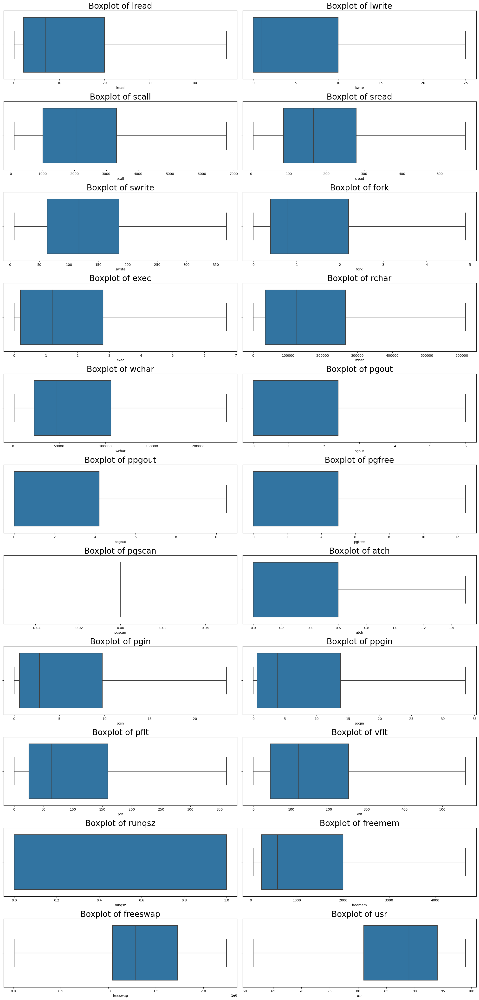

In [18]:
plt.figure(figsize=(20,60))
features=df.columns
for f in range(0,len(features)):
    plt.subplot(16,2,f+1)
    sns.boxplot(data=df,x=df.columns[f])
    plt.title(f"Boxplot of {df.columns[f]}",fontsize=24)
    plt.tight_layout();

In [19]:
df.head()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgscan,atch,pgin,ppgin,pflt,vflt,runqsz,freemem,freeswap,usr
0,1.0,0.0,2147.0,79.0,68.0,0.2,0.2,40671.0,53995.0,0.0,...,0.0,0.0,1.6,2.6,16.00,26.40,1.0,4659.125,1730946.0,95.0
1,0.0,0.0,170.0,18.0,21.0,0.2,0.2,448.0,8385.0,0.0,...,0.0,0.0,0.0,0.0,15.63,16.83,0.0,4659.125,1869002.0,97.0
2,15.0,3.0,2162.0,159.0,119.0,2.0,2.4,125473.5,31950.0,0.0,...,0.0,1.2,6.0,9.4,150.20,220.20,0.0,702.000,1021237.0,87.0
3,0.0,0.0,160.0,12.0,16.0,0.2,0.2,125473.5,8670.0,0.0,...,0.0,0.0,0.2,0.2,15.60,16.80,0.0,4659.125,1863704.0,98.0
4,5.0,1.0,330.0,39.0,38.0,0.4,0.4,125473.5,12185.0,0.0,...,0.0,0.0,1.0,1.2,37.80,47.60,0.0,633.000,1760253.0,90.0


In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8192 entries, 0 to 8191
Data columns (total 22 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   lread     8192 non-null   float64
 1   lwrite    8192 non-null   float64
 2   scall     8192 non-null   float64
 3   sread     8192 non-null   float64
 4   swrite    8192 non-null   float64
 5   fork      8192 non-null   float64
 6   exec      8192 non-null   float64
 7   rchar     8192 non-null   float64
 8   wchar     8192 non-null   float64
 9   pgout     8192 non-null   float64
 10  ppgout    8192 non-null   float64
 11  pgfree    8192 non-null   float64
 12  pgscan    8192 non-null   float64
 13  atch      8192 non-null   float64
 14  pgin      8192 non-null   float64
 15  ppgin     8192 non-null   float64
 16  pflt      8192 non-null   float64
 17  vflt      8192 non-null   float64
 18  runqsz    8192 non-null   float64
 19  freemem   8192 non-null   float64
 20  freeswap  8192 non-null   floa

In [21]:
for i in range(0,21):
    print(f'{df.columns[i]}: {df[df[df.columns[i]]==0].index.value_counts().sum()}')

lread: 675
lwrite: 2684
scall: 0
sread: 0
swrite: 0
fork: 21
exec: 21
rchar: 0
wchar: 0
pgout: 4878
ppgout: 4878
pgfree: 4869
pgscan: 8192
atch: 4575
pgin: 1220
ppgin: 1220
pflt: 3
vflt: 0
runqsz: 4331
freemem: 0
freeswap: 0


In [22]:
for i in range(0,21):
    print(f'{df.columns[i]}: {df[df[df.columns[i]]<0].index.value_counts().sum()}')

### NO NEGATIVE VALUES

lread: 0
lwrite: 0
scall: 0
sread: 0
swrite: 0
fork: 0
exec: 0
rchar: 0
wchar: 0
pgout: 0
ppgout: 0
pgfree: 0
pgscan: 0
atch: 0
pgin: 0
ppgin: 0
pflt: 0
vflt: 0
runqsz: 0
freemem: 0
freeswap: 0


In [23]:
df.drop('pgscan',axis=1,inplace=True)

### DROPPED pgscan COLUMN because it's a column with all 0 values

##### Univariate Analysis

In [24]:
df.columns

Index(['lread', 'lwrite', 'scall', 'sread', 'swrite', 'fork', 'exec', 'rchar',
       'wchar', 'pgout', 'ppgout', 'pgfree', 'atch', 'pgin', 'ppgin', 'pflt',
       'vflt', 'runqsz', 'freemem', 'freeswap', 'usr'],
      dtype='object')

In [25]:
df.lread.unique()

array([ 1.,  0., 15.,  5., 21.,  4.,  6., 25.,  3., 11., 17., 47., 18.,
        2., 13., 10., 16., 19.,  8., 14., 36., 20.,  7., 46., 33., 12.,
       37., 42., 26., 23.,  9., 30., 29., 31., 22., 41., 28., 24., 35.,
       40., 43., 44., 27., 34., 45., 39., 38., 32.])

In [26]:
df.lwrite.unique()

array([ 0.,  3.,  1., 18.,  9.,  4., 24.,  2., 11., 23.,  5., 25.,  7.,
        6., 12., 14., 17., 22., 19., 15., 13., 10.,  8., 16., 21., 20.])

In [27]:
df.scall.nunique()

4016

In [28]:
df.sread.unique()

array([ 79. ,  18. , 159. ,  12. ,  39. ,  65. , 168. , 291. ,  42. ,
        13. , 191. , 144. , 245. ,  45. ,  74. , 177. ,  47. , 125. ,
       259. ,  14. , 166. ,  27. , 428. , 179. , 172. ,  87. , 192. ,
       568.5, 518. , 411. , 249. , 212. , 120. , 149. , 216. , 171. ,
        68. , 141. ,  22. , 147. , 341. ,  85. ,  40. , 133. , 247. ,
       174. , 357. , 279. , 466. ,  37. , 254. , 155. , 126. , 239. ,
       293. , 211. ,  73. ,  69. , 107. ,  90. ,  55. , 199. , 495. ,
       312. , 142. , 103. ,  16. ,  84. , 175. ,  67. ,  59. , 153. ,
        72. , 140. ,  62. , 284. ,  86. ,   9. ,  44. ,  35. , 463. ,
       370. , 281. ,  91. , 134. , 271. ,  17. , 367. , 178. ,  32. ,
       429. , 327. , 154. , 238. ,  80. , 314. ,  11. , 347. , 339. ,
       316. , 261. ,  41. , 182. , 148. , 122. , 232. , 338. , 436. ,
       123. ,  52. ,  61. , 158. ,  49. , 364. , 317. , 131. ,  82. ,
       554. ,  66. , 302. , 208. , 330. , 193. , 248. , 297. ,   7. ,
       164. ,  99. ,

In [29]:
df.swrite.unique()

array([ 68.,  21., 119.,  16.,  38.,  61., 190., 211.,  33.,  24., 152.,
       103., 135., 196.,  44., 151.,  65.,  79., 163.,  52.,  37., 200.,
       136.,  82.,  71., 167., 238., 234., 355., 368.,  40.,  90., 115.,
       162.,  34.,  91.,  19., 111., 201.,  50.,  15.,  26.,  41., 197.,
       219.,  87., 144., 205., 338.,  20.,  77., 134., 212., 236., 153.,
       186., 337.,  30., 114.,  12., 116.,  62., 138., 282., 123.,  29.,
       118.,  76.,  22.,  13., 137.,  66., 109.,  45.,  81.,  51., 248.,
        39., 261., 194.,  63., 126.,  74.,  69.,  49., 172., 232.,  14.,
        80., 214., 106., 120., 202., 318., 258.,  43., 298., 271., 166.,
        84.,  96., 102.,  47., 233., 365.,  67.,  88.,  18., 124., 174.,
       336., 288., 242., 110.,  42., 283., 158., 241., 141., 108., 189.,
       121.,  53., 294.,  85., 273., 278., 228.,  78., 160.,  55., 213.,
       122., 139., 157., 348., 222.,  99., 224., 292., 182., 105., 155.,
       171., 185., 181., 142.,  94., 289., 168.,  3

In [30]:
df.fork.unique()

array([0.2 , 2.  , 0.4 , 0.6 , 0.8 , 2.4 , 4.2 , 1.2 , 4.9 , 1.39, 2.2 ,
       1.  , 4.8 , 2.8 , 1.8 , 4.4 , 3.4 , 4.6 , 1.4 , 2.58, 1.6 , 3.61,
       4.79, 3.6 , 2.79, 2.99, 0.97, 3.8 , 2.59, 3.2 , 2.6 , 3.19, 0.39,
       3.  , 2.81, 4.  , 0.  , 3.99, 3.39, 3.59, 4.59, 4.38, 1.78, 3.01,
       1.19, 3.79, 4.01, 0.99, 3.41, 2.19, 4.19, 3.18, 3.78, 4.39, 1.59,
       1.37, 1.99, 4.81, 2.61, 0.19, 3.81, 3.21, 2.39, 1.79, 4.41, 4.77,
       4.18, 4.21, 3.56, 0.59, 3.38, 3.58, 4.61, 4.17, 1.34])

In [31]:
df.exec.unique()

array([0.2 , 2.4 , 0.4 , 0.8 , 6.7 , 1.8 , 5.2 , 1.  , 1.59, 2.2 , 2.6 ,
       2.  , 3.59, 5.  , 3.6 , 0.6 , 4.6 , 1.6 , 4.2 , 1.2 , 4.  , 3.  ,
       2.61, 2.39, 5.8 , 3.76, 2.79, 2.8 , 3.4 , 3.79, 1.4 , 2.81, 5.98,
       4.01, 5.01, 3.99, 4.8 , 3.8 , 2.7 , 6.2 , 6.6 , 2.99, 3.19, 0.39,
       3.2 , 5.4 , 4.4 , 3.21, 3.41, 3.39, 0.  , 2.19, 3.01, 2.59, 3.61,
       3.98, 3.81, 6.01, 4.21, 4.19, 4.39, 5.6 , 4.41, 0.59, 6.61, 5.19,
       1.99, 6.39, 4.99, 0.79, 5.21, 3.18, 2.78, 6.  , 0.99, 5.79, 4.79,
       5.59, 5.39, 3.13, 6.59, 6.4 , 1.79, 5.61, 5.99, 1.39, 0.19, 4.61,
       6.41, 5.41, 4.58, 2.38, 5.78, 2.98, 6.21, 4.38, 3.17, 4.97, 6.19,
       5.57, 5.81, 4.59, 4.81, 2.58, 5.35, 6.16, 6.18, 3.38, 5.38, 5.45,
       2.17, 4.78, 1.19, 4.18, 3.78, 4.37])

In [32]:
df.rchar.nunique()

7435

In [33]:
df['wchar'].nunique()

7111

In [34]:
df['pgout'].unique()

array([0.  , 6.  , 2.6 , 0.2 , 1.8 , 0.8 , 2.4 , 3.79, 4.2 , 5.19, 3.8 ,
       5.6 , 5.4 , 2.  , 1.4 , 3.6 , 1.2 , 5.8 , 2.2 , 0.4 , 1.6 , 2.97,
       3.2 , 2.19, 3.78, 4.  , 4.8 , 3.98, 5.  , 1.  , 3.4 , 4.39, 4.79,
       5.38, 0.6 , 4.6 , 3.61, 5.2 , 3.99, 3.  , 2.99, 3.39, 4.41, 2.81,
       3.19, 1.79, 4.19, 4.99, 3.59, 2.79, 2.8 , 3.41, 5.39, 4.01, 4.4 ,
       5.99, 0.79, 2.34, 5.01, 5.41, 4.98, 5.81, 5.79, 1.39, 3.21, 4.21,
       0.99, 1.59, 4.81, 5.21, 4.38, 5.58, 2.59, 3.81, 5.61, 2.98, 3.17,
       4.59, 3.01, 5.59, 2.61, 4.61, 1.98, 5.98, 4.78, 5.18, 2.57, 4.18,
       4.76, 0.59, 4.97, 5.17, 3.58])

In [35]:
df['ppgout'].unique()

array([ 0.  ,  8.8 ,  4.8 ,  0.2 ,  1.8 ,  0.8 ,  2.6 ,  4.79, 10.5 ,
        4.2 ,  9.58,  4.6 , 10.2 ,  1.6 ,  7.  ,  1.2 ,  9.2 ,  2.  ,
        0.4 ,  2.2 ,  2.4 ,  2.97,  5.2 ,  4.17,  3.78,  5.6 ,  8.2 ,
        8.62,  4.58,  9.4 ,  3.6 ,  1.4 ,  9.18,  7.2 ,  1.  ,  8.  ,
        0.6 ,  5.4 ,  6.6 ,  3.4 ,  5.98,  9.6 , 10.  ,  7.4 ,  5.79,
        3.8 ,  9.8 ,  2.39,  5.21, 10.4 ,  7.41,  2.8 ,  7.78,  3.99,
        6.8 ,  8.98,  4.39,  3.58,  7.8 ,  0.99,  9.  ,  9.38,  5.58,
        6.  ,  3.19,  7.58,  3.  ,  4.  ,  5.39,  3.2 ,  6.01, 10.02,
        6.79,  3.39,  6.2 ,  8.6 ,  5.  ,  5.8 ,  4.4 ,  9.78,  8.42,
        2.81,  7.82,  8.4 ,  5.61,  6.19,  3.41,  1.19,  2.79,  5.41,
        6.39,  7.6 ,  3.59,  8.38,  3.13,  9.82,  6.99,  4.81,  2.61,
        8.78,  6.21,  3.79,  1.59,  6.4 ,  6.59,  3.81,  4.99,  4.01,
        5.01,  6.81,  1.39,  2.19,  2.58,  8.17,  9.98,  5.81,  7.57,
        2.59,  5.19,  4.21,  4.59,  5.59,  1.99,  3.61,  9.22,  7.19,
        3.01,  6.41,

In [36]:
 df['pgfree'].unique()

array([ 0.  ,  8.  ,  4.8 ,  0.2 ,  1.8 , 12.5 ,  2.6 ,  4.59,  4.2 ,
       10.2 ,  1.6 , 10.6 , 10.4 ,  1.2 ,  4.81,  0.4 ,  2.2 ,  2.4 ,
        2.77,  4.6 ,  4.17,  3.78,  5.6 ,  2.  ,  4.58,  9.4 ,  7.6 ,
       11.8 ,  1.4 ,  1.  ,  6.4 ,  9.8 ,  0.6 ,  5.2 ,  4.79,  3.4 ,
       10.  ,  3.6 ,  9.  ,  3.  ,  0.8 ,  6.6 , 11.18,  3.8 ,  2.39,
        8.2 ,  5.19, 11.42,  6.99,  3.19,  2.8 ,  9.2 ,  9.6 ,  3.58,
        6.8 ,  8.6 ,  8.8 ,  5.58,  6.79,  6.  ,  6.01,  4.99,  7.  ,
        5.8 ,  8.58,  3.39, 10.8 ,  3.2 , 11.58,  4.4 ,  4.  ,  2.81,
        7.82,  9.18,  9.82,  5.39,  4.61,  1.19,  2.79,  5.4 , 12.2 ,
        6.19,  5.  , 12.  , 11.4 ,  8.38,  2.54,  5.79,  9.78,  7.2 ,
        5.61, 11.2 ,  2.61,  6.2 ,  7.8 ,  7.4 ,  4.39, 12.38, 10.38,
        4.78,  8.78,  3.21, 11.  , 11.98,  3.81,  7.78,  9.58,  8.98,
        3.99,  9.62,  5.21, 11.38, 11.78,  1.39,  8.62,  2.78,  9.13,
       11.35, 10.18,  5.81,  7.57,  8.4 ,  8.82,  1.99,  3.61,  6.41,
        3.01, 10.58,

In [37]:
df['atch'].unique()

array([0.  , 1.2 , 1.5 , 0.2 , 0.8 , 0.4 , 1.  , 0.6 , 1.4 , 1.39, 1.19,
       0.79, 0.99, 1.15])

In [38]:
df['pgin'].unique()

array([ 1.6   ,  0.    ,  6.    ,  0.2   ,  1.    ,  0.6   ,  0.4   ,
        1.2   , 20.8   ,  4.2   , 11.4   ,  5.99  ,  1.4   , 23.5125,
       11.95  , 11.38  ,  2.    ,  0.8   ,  2.59  ,  3.6   , 11.8   ,
        3.4   , 11.    ,  8.6   , 21.    ,  2.8   ,  3.2   ,  3.19  ,
        9.98  ,  7.6   ,  5.4   ,  6.4   , 14.2   ,  5.01  , 16.4   ,
        3.8   ,  5.6   ,  7.13  ,  5.    ,  5.2   ,  2.98  ,  2.4   ,
        0.99  , 14.8   , 17.6   , 22.6   ,  2.2   , 15.8   , 17.84  ,
        4.39  ,  7.41  ,  4.41  , 13.15  , 18.2   , 17.    , 10.82  ,
        2.99  , 20.36  ,  7.    ,  4.    ,  8.2   ,  9.8   , 16.6   ,
        1.8   , 15.17  , 13.2   ,  8.98  , 10.4   , 18.56  , 17.56  ,
        4.19  ,  8.4   ,  6.8   ,  5.8   ,  1.74  , 14.4   ,  7.21  ,
        2.6   ,  9.4   , 23.26  , 21.6   , 10.6   ,  4.8   , 15.97  ,
       14.    ,  2.79  ,  4.6   ,  7.2   , 14.6   , 16.8   ,  8.58  ,
       12.6   ,  8.38  ,  8.8   ,  2.16  ,  5.79  ,  4.58  ,  7.78  ,
       13.4   , 23.0

In [39]:
df['ppgin'].unique()

array([ 2.6 ,  0.  ,  9.4 ,  0.2 ,  1.2 ,  0.6 ,  1.  ,  0.8 ,  1.6 ,
       23.6 ,  0.4 ,  7.4 , 11.8 ,  5.99,  1.8 , 33.6 , 21.91, 11.58,
        2.2 ,  3.79,  3.8 , 13.  ,  5.4 , 15.8 ,  8.6 , 33.4 ,  4.2 ,
        4.  ,  5.59,  3.  , 17.37, 14.2 ,  8.  ,  9.8 , 27.6 , 26.15,
        3.4 ,  6.  ,  7.41,  1.4 , 20.4 ,  6.6 ,  5.6 ,  7.33,  9.  ,
        2.  ,  8.8 ,  5.37,  2.59,  3.59,  1.19, 27.  , 16.6 , 11.  ,
        2.4 , 20.  , 24.2 , 29.2 , 17.6 , 13.2 ,  8.18, 10.02,  5.  ,
       13.75, 31.8 , 29.6 , 19.6 , 22.  , 20.84,  4.8 ,  4.39, 22.75,
        7.  , 11.2 , 10.8 ,  6.4 , 15.17, 22.4 ,  8.98, 31.6 , 21.2 ,
       22.6 , 27.54, 17.56,  5.39, 12.2 , 16.8 ,  6.8 ,  1.74,  5.8 ,
       24.6 , 13.03,  3.6 ,  2.8 , 31.21, 18.8 ,  4.19,  7.2 , 23.4 ,
       30.4 , 10.6 , 14.97,  3.54,  5.79,  5.18,  5.2 ,  9.58, 22.8 ,
       15.6 , 20.8 , 10.18, 22.44, 13.6 , 25.6 , 14.8 , 20.6 , 21.6 ,
       19.2 , 19.64,  3.2 , 10.4 ,  9.2 ,  6.2 , 16.  , 30.8 ,  2.79,
       12.22, 32.8 ,

In [40]:
df['pflt'].nunique()

2637

In [41]:
df['vflt'].nunique()

3341

In [42]:
df['runqsz'].unique()

array([1., 0.])

In [43]:
df['freemem'].nunique()

2195

In [44]:
df['freeswap'].nunique()

7624

In [45]:
df['usr'].unique()

array([95. , 97. , 87. , 98. , 90. , 96. , 89. , 61.5, 92. , 75. , 94. ,
       85. , 93. , 83. , 81. , 86. , 88. , 72. , 99. , 82. , 73. , 91. ,
       71. , 77. , 74. , 84. , 70. , 76. , 80. , 66. , 78. , 79. , 65. ,
       69. , 68. , 64. , 63. , 67. , 62. ])

##### Bivariate Analysis

In [46]:
df.columns

Index(['lread', 'lwrite', 'scall', 'sread', 'swrite', 'fork', 'exec', 'rchar',
       'wchar', 'pgout', 'ppgout', 'pgfree', 'atch', 'pgin', 'ppgin', 'pflt',
       'vflt', 'runqsz', 'freemem', 'freeswap', 'usr'],
      dtype='object')

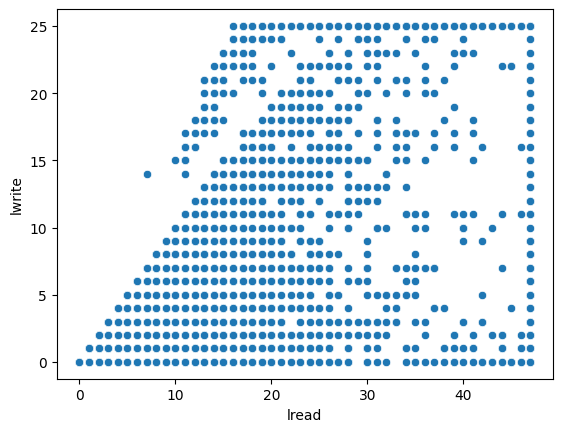

In [47]:
sns.scatterplot(data=df,x=df.lread,y=df.lwrite);

### unclear if there is correlation

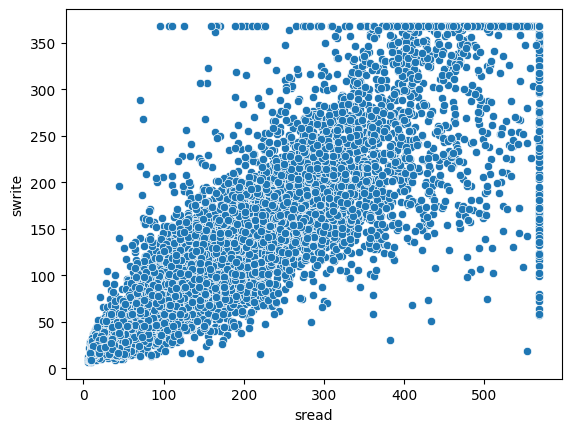

In [48]:
sns.scatterplot(data=df,x=df.sread,y=df.swrite);

### correlation spotted

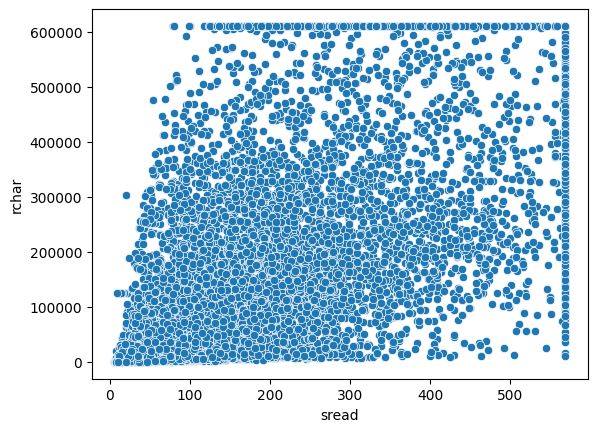

In [49]:
sns.scatterplot(data=df,x=df.sread,y=df.rchar);

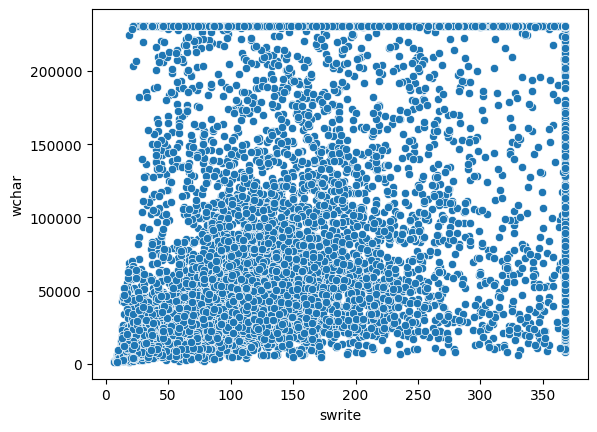

In [50]:
sns.scatterplot(data=df,x=df.swrite,y=df.wchar);

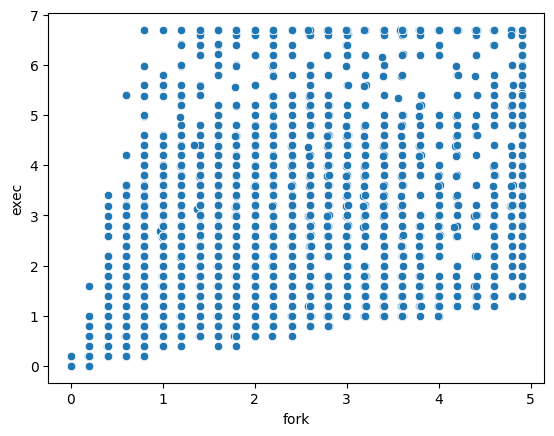

In [51]:
sns.scatterplot(data=df,x=df.fork,y=df.exec);

<Figure size 2000x1200 with 0 Axes>

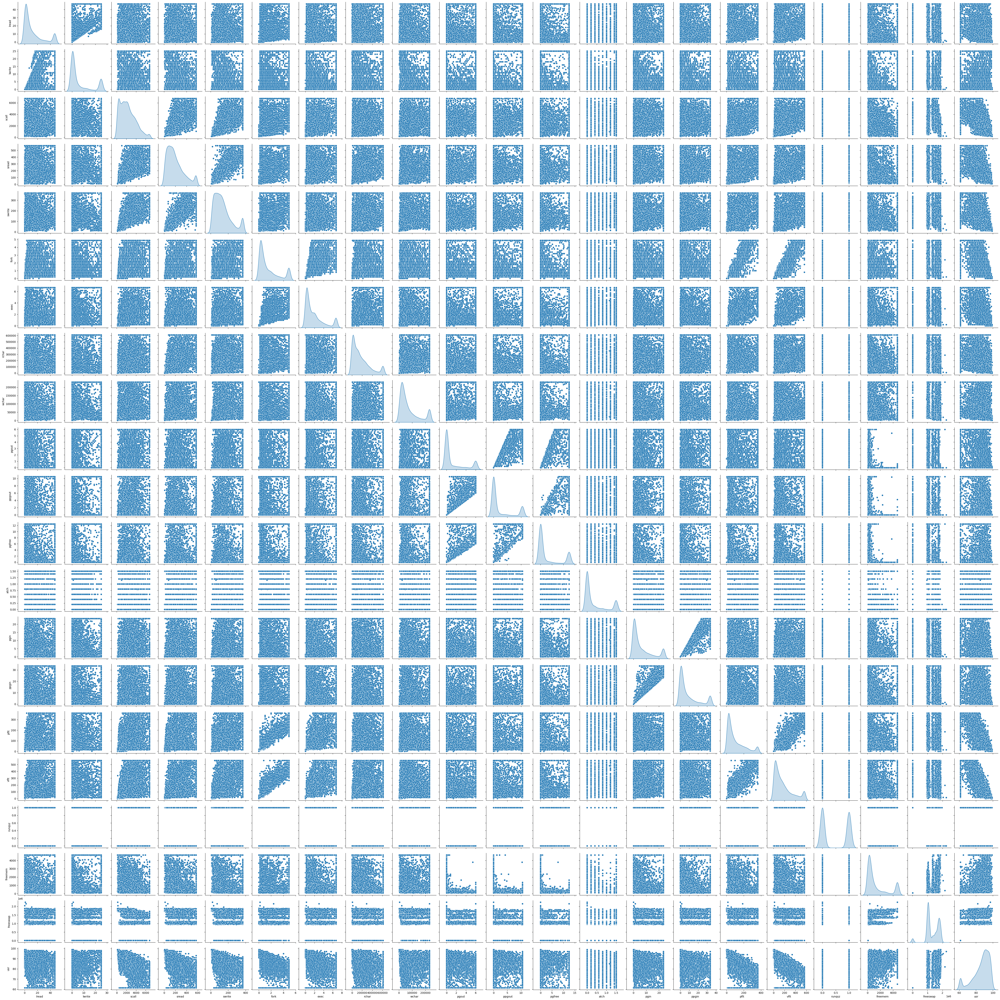

In [52]:
fig=plt.figure(figsize=(20,12))
sns.pairplot(df,diag_kind="kde")

In [53]:
corr = df.corr()
round(corr,2)

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgfree,atch,pgin,ppgin,pflt,vflt,runqsz,freemem,freeswap,usr
lread,1.00,0.83,0.33,0.33,0.31,0.37,0.36,0.26,0.17,0.21,...,0.21,0.23,0.28,0.29,0.38,0.42,0.14,-0.20,-0.24,-0.44
lwrite,0.83,1.00,0.14,0.15,0.13,0.09,0.12,0.12,0.13,0.09,...,0.08,0.13,0.11,0.12,0.10,0.14,0.05,-0.10,-0.15,-0.19
scall,0.33,0.14,1.00,0.76,0.74,0.47,0.44,0.39,0.33,0.30,...,0.30,0.31,0.34,0.33,0.49,0.55,0.25,-0.39,-0.36,-0.62
sread,0.33,0.15,0.76,1.00,0.88,0.53,0.37,0.58,0.42,0.30,...,0.31,0.29,0.35,0.34,0.53,0.60,0.23,-0.35,-0.37,-0.64
swrite,0.31,0.13,0.74,0.88,1.00,0.52,0.31,0.42,0.43,0.27,...,0.28,0.26,0.31,0.30,0.51,0.56,0.22,-0.35,-0.34,-0.60
fork,0.37,0.09,0.47,0.53,0.52,1.00,0.77,0.37,0.12,0.20,...,0.22,0.20,0.25,0.24,0.94,0.93,0.12,-0.14,-0.13,-0.67
exec,0.36,0.12,0.44,0.37,0.31,0.77,1.00,0.32,0.12,0.23,...,0.25,0.25,0.30,0.29,0.76,0.76,0.13,-0.19,-0.18,-0.61
rchar,0.26,0.12,0.39,0.58,0.42,0.37,0.32,1.00,0.49,0.25,...,0.26,0.27,0.37,0.39,0.38,0.44,0.24,-0.17,-0.23,-0.51
wchar,0.17,0.13,0.33,0.42,0.43,0.12,0.12,0.49,1.00,0.20,...,0.19,0.16,0.25,0.26,0.13,0.16,0.25,-0.15,-0.18,-0.32
pgout,0.21,0.09,0.30,0.30,0.27,0.20,0.23,0.25,0.20,1.00,...,0.91,0.64,0.44,0.45,0.21,0.30,0.02,-0.47,-0.35,-0.38


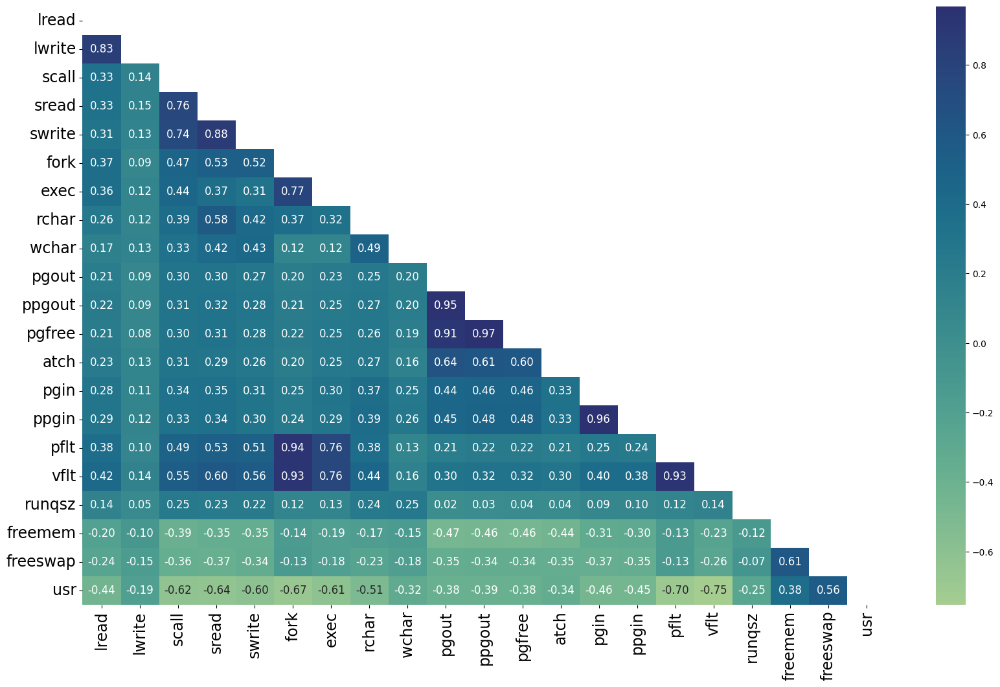

In [54]:
plt.figure(figsize=(20,12))
mask = np.triu(np.ones_like(df.corr()))
sns.heatmap(df.corr(),annot=True,fmt='.2f',cmap='crest',mask=mask,annot_kws={'size':12})
plt.xticks(fontsize=17)
plt.yticks(fontsize=17);

In [55]:
### vflt and pflt are negatively correlated with usr
### fork calls per second and usr also seem to be negatively correlated, although not a very strong correlation
### vflt and pflt is stringly correlated with fork calls per second
### pflt and vflt have strong correlation
### number of exec calls per second also seem to have pflt and vflt but not as much as fork calls per second
### ppgout and pgout have good correlation, i.e., the number of pages paged out per second is in tune with the
# number of page out requests per second

### to reduce usr, we need to investigate the cause of correlation between fork and vflt,pflt

In [56]:
df.columns

Index(['lread', 'lwrite', 'scall', 'sread', 'swrite', 'fork', 'exec', 'rchar',
       'wchar', 'pgout', 'ppgout', 'pgfree', 'atch', 'pgin', 'ppgin', 'pflt',
       'vflt', 'runqsz', 'freemem', 'freeswap', 'usr'],
      dtype='object')

In [57]:
df.groupby('runqsz').pflt.mean()

runqsz
0.0     93.738677
1.0    118.981735
Name: pflt, dtype: float64

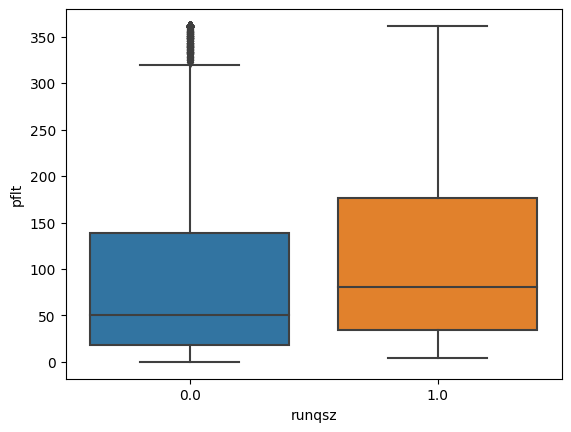

In [58]:
sns.boxplot(y=df.pflt, x=df.runqsz, data=df);

### page faults caused by protection errors are significantly higher in CPU_bound than Not_CPU_Bound

In [59]:
df.runqsz.value_counts()

### 1 is bound
### 0 is not bound

0.0    4331
1.0    3861
Name: runqsz, dtype: int64

##### Multivariate Analysis

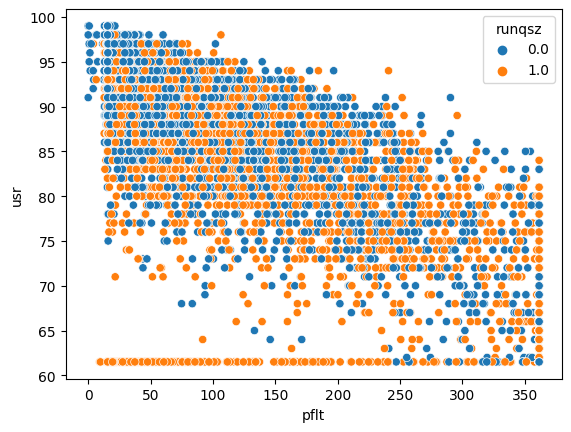

In [60]:
sns.scatterplot(data=df,x=df.pflt,y=df.usr,hue=df.runqsz);

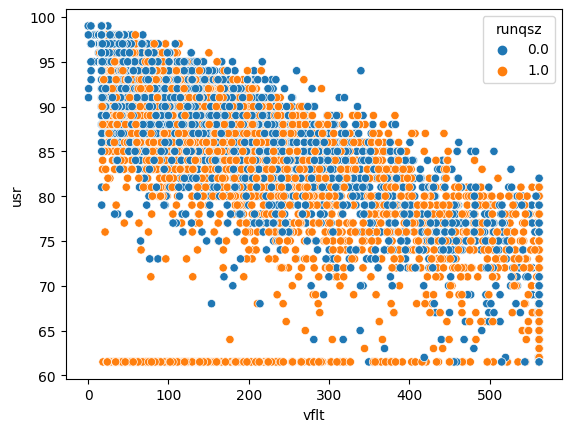

In [61]:
sns.scatterplot(data=df,x=df.vflt,y=df.usr,hue=df.runqsz);

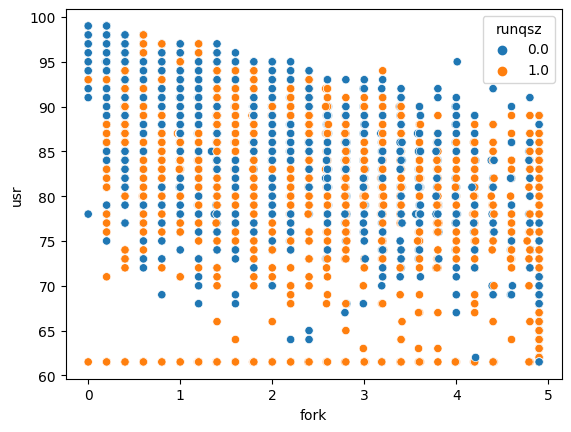

In [62]:
sns.scatterplot(data=df,x=df.fork,y=df.usr,hue=df.runqsz);

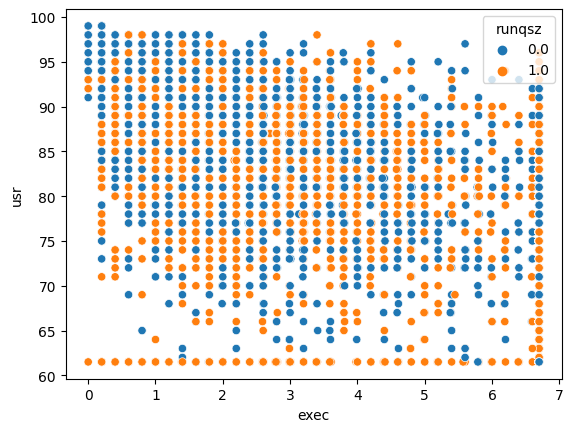

In [63]:
sns.scatterplot(data=df,x=df.exec,y=df.usr,hue=df.runqsz);

#### 1.2 Impute null values if present, also check for the values which are equal to zero. Do they have any meaning or do we need to change them or drop them? Check for the possibility of creating new features if required. Also check for outliers and duplicates if there. - 5 marks

In [64]:
### null values already imputed
### pgscan was dropped because most of the values in this column were 0
### no new features created/required yet
### outliers have been checked and treated
### runqsz has been converted to numeric with values 0 and 1

#### 1.3 Encode the data (having string values) for Modelling. Split the data into train and test (70:30). Apply Linear regression using scikit learn. Perform checks for significant variables using appropriate method from statsmodel. Create multiple models and check the performance of Predictions on Train and Test sets using Rsquare, RMSE & Adj Rsquare. Compare these models and select the best one with appropriate reasoning. - 12 marks

In [65]:
### DATA ENCODED ALREADY

In [66]:
### SPLITTING THE DATA
# independent variables
X=df.drop(["usr"], axis=1)
# dependent variable
y=df.usr

In [67]:
import statsmodels.api as sm
# adding intercept
X=sm.add_constant(X)

In [68]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error,mean_squared_error

In [69]:
### TRAIN_TEST SPLIT
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.30,random_state=42)

In [70]:
X_train.head()

,const,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,...,ppgout,pgfree,atch,pgin,ppgin,pflt,vflt,runqsz,freemem,freeswap
1310,1.0,26.0,25.0,5731.0,312.0,224.0,0.8,0.80,155004.0,230625.875,...,0.00,0.00,1.5,0.2000,0.20,48.8,134.00,1.0,249.0,1383946.0
7365,1.0,15.0,3.0,1203.0,61.0,34.0,1.6,1.80,163076.0,33674.000,...,0.00,0.00,0.0,0.0000,0.00,127.8,199.40,1.0,2744.0,1542915.0
2284,1.0,39.0,16.0,5213.0,568.5,368.0,4.9,4.99,435848.0,230625.875,...,9.98,10.18,1.5,15.7700,17.56,348.1,561.40,1.0,236.0,1002172.0
7076,1.0,2.0,0.0,2585.0,203.0,145.0,0.6,0.60,329604.0,126738.000,...,1.80,1.00,0.8,23.5125,30.46,49.9,194.39,0.0,451.0,1057294.0
3114,1.0,2.0,1.0,1827.0,65.0,88.0,0.4,0.20,4487.0,8828.000,...,0.00,0.00,0.0,0.2000,0.20,17.4,17.00,0.0,689.0,1752789.0


In [71]:
X_test.head()

,const,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,...,ppgout,pgfree,atch,pgin,ppgin,pflt,vflt,runqsz,freemem,freeswap
5670,1.0,14.0,7.0,1495.0,197.0,169.0,0.8,1.0,10304.000,24435.000,...,10.5,12.5,1.0,2.0000,2.00,63.07,106.79,1.0,186.0,974392.0
5369,1.0,10.0,8.0,3158.0,324.0,172.0,0.6,2.2,611196.125,230625.875,...,0.0,0.0,0.0,23.5125,33.60,46.00,79.20,1.0,510.0,1032922.0
2111,1.0,2.0,0.0,813.0,117.0,113.0,1.8,0.6,59903.000,24550.000,...,2.2,7.2,0.0,0.0000,0.00,96.00,135.60,0.0,179.0,1761718.0
6659,1.0,47.0,25.0,3283.0,134.0,125.0,0.4,0.4,33832.000,23626.000,...,9.0,9.0,0.6,1.8000,2.20,36.40,56.20,0.0,461.0,1129531.0
5227,1.0,12.0,2.0,2357.0,113.0,96.0,4.9,6.7,55137.000,36291.000,...,0.0,0.0,0.0,8.3800,12.18,231.14,423.35,0.0,530.0,1077027.0


##### Fitting the model

In [72]:
olsmod=sm.OLS(y_train,X_train)
model=olsmod.fit()

In [73]:
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.793
Model:                            OLS   Adj. R-squared:                  0.792
Method:                 Least Squares   F-statistic:                     1093.
Date:                Sat, 23 Sep 2023   Prob (F-statistic):               0.00
Time:                        12:53:00   Log-Likelihood:                -16686.
No. Observations:                5734   AIC:                         3.341e+04
Df Residuals:                    5713   BIC:                         3.355e+04
Df Model:                          20                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         85.0494      0.298    285.844      0.0

In [74]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif1=pd.Series(
    [variance_inflation_factor(X_train.values,i) for i in range(X_train.shape[1])],
    index=X_train.columns
)
print(f"VIF values: \n\n{vif1}\n")

VIF values: 

const       25.629887
lread        5.222496
lwrite       4.230336
scall        2.987824
sread        6.555928
swrite       5.666273
fork        13.195160
exec         3.216047
rchar        2.088006
wchar        1.583353
pgout       11.215199
ppgout      30.947431
pgfree      17.468614
atch         1.848297
pgin        14.475734
ppgin       14.673035
pflt        11.703237
vflt        15.370510
runqsz       1.151214
freemem      1.974160
freeswap     1.847552
dtype: float64



In [75]:
### DROPPING VARIABLES ONE BY ONE TO CHECK ADJ. R-SQUARE

In [76]:
X_train1 = X_train.drop(["ppgout"], axis=1)
olsmod_1 = sm.OLS(y_train, X_train1)
model_1 = olsmod_1.fit()
print(
    "R-squared:",
    np.round(model_1.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(model_1.rsquared_adj, 3),
)

R-squared: 0.793 
Adjusted R-squared: 0.792


In [77]:
X_train2 = X_train.drop(["pgfree"], axis=1)
olsmod_2 = sm.OLS(y_train, X_train2)
model_2 = olsmod_2.fit()
print(
    "R-squared:",
    np.round(model_2.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(model_2.rsquared_adj, 3),
)

### no effect on Adj. R-squared but R-squared dropped by 0.001

R-squared: 0.792 
Adjusted R-squared: 0.792


In [78]:
X_train3 = X_train.drop(["pgin"], axis=1)
olsmod_3 = sm.OLS(y_train, X_train3)
model_3 = olsmod_3.fit()
print(
    "R-squared:",
    np.round(model_3.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(model_3.rsquared_adj, 3),
)

R-squared: 0.793 
Adjusted R-squared: 0.792


In [79]:
X_train4 = X_train.drop(["ppgin"], axis=1)
olsmod_4 = sm.OLS(y_train, X_train4)
model_4 = olsmod_4.fit()
print(
    "R-squared:",
    np.round(model_4.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(model_4.rsquared_adj, 3),
)

### R-squared and Adj. R-squared dropped by 0.001

R-squared: 0.792 
Adjusted R-squared: 0.791


In [80]:
X_train5 = X_train.drop(["fork"], axis=1)
olsmod_5 = sm.OLS(y_train, X_train5)
model_5 = olsmod_5.fit()
print(
    "R-squared:",
    np.round(model_5.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(model_5.rsquared_adj, 3),
)

R-squared: 0.793 
Adjusted R-squared: 0.792


In [81]:
X_train6 = X_train.drop(["vflt"], axis=1)
olsmod_6 = sm.OLS(y_train, X_train6)
model_6 = olsmod_6.fit()
print(
    "R-squared:",
    np.round(model_6.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(model_6.rsquared_adj, 3),
)

### R-squared and adj. R-squared dropped by 0.001

R-squared: 0.792 
Adjusted R-squared: 0.791


In [82]:
X_train7 = X_train.drop(["pflt"], axis=1)
olsmod_7 = sm.OLS(y_train, X_train7)
model_7 = olsmod_7.fit()
print(
    "R-squared:",
    np.round(model_7.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(model_7.rsquared_adj, 3),
)

### R-squared and adj. R-squared dropped by 0.009

R-squared: 0.783 
Adjusted R-squared: 0.782


##### Compared to all others, removing 'pflt' results in a steeper decline in R-squared value.
##### Hence, it is important to be kept.

In [83]:
### Dropping 'ppgout' to check how the model responds

In [84]:
X_train = X_train.drop(["ppgout"], axis=1)

In [85]:
olsmod_8 = sm.OLS(y_train, X_train)
model_8 = olsmod_8.fit()
print(model_8.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.793
Model:                            OLS   Adj. R-squared:                  0.792
Method:                 Least Squares   F-statistic:                     1150.
Date:                Sat, 23 Sep 2023   Prob (F-statistic):               0.00
Time:                        12:53:01   Log-Likelihood:                -16687.
No. Observations:                5734   AIC:                         3.341e+04
Df Residuals:                    5714   BIC:                         3.355e+04
Df Model:                          19                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         85.0682      0.297    286.732      0.0

In [86]:
vif_2=pd.Series(
    [variance_inflation_factor(X_train.values,i) for i in range(X_train.shape[1])],
    index=X_train.columns
)
print(f"VIF values after dropping 'ppgout': \n\n{vif_2}\n")

VIF values after dropping 'ppgout': 

const       25.484056
lread        5.220098
lwrite       4.229441
scall        2.987783
sread        6.555363
swrite       5.666264
fork        13.188017
exec         3.214984
rchar        2.088006
wchar        1.580437
pgout        6.324897
pgfree       6.097389
atch         1.847637
pgin        14.437958
ppgin       14.617568
pflt        11.703237
vflt        15.362860
runqsz       1.151159
freemem      1.972182
freeswap     1.845464
dtype: float64



In [87]:
X_train9 = X_train.drop(["ppgin"], axis=1)
olsmod_9 = sm.OLS(y_train, X_train9)
model_9 = olsmod_9.fit()
print(
    "R-squared:",
    np.round(model_9.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(model_9.rsquared_adj, 3),
)

### no drop from the previous cycle

R-squared: 0.792 
Adjusted R-squared: 0.791


In [88]:
X_train10 = X_train.drop(["vflt"], axis=1)
olsmod_10 = sm.OLS(y_train, X_train10)
model_10 = olsmod_10.fit()
print(
    "R-squared:",
    np.round(model_10.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(model_10.rsquared_adj, 3),
)

### no drop from the previous cycle

R-squared: 0.792 
Adjusted R-squared: 0.791


In [89]:
X_train11 = X_train.drop(["fork"], axis=1)
olsmod_11 = sm.OLS(y_train, X_train11)
model_11 = olsmod_11.fit()
print(
    "R-squared:",
    np.round(model_11.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(model_11.rsquared_adj, 3),
)

### no drop from the previous cycle

R-squared: 0.793 
Adjusted R-squared: 0.792


In [90]:
X_train12 = X_train.drop(["pgin"], axis=1)
olsmod_12 = sm.OLS(y_train, X_train12)
model_12 = olsmod_12.fit()
print(
    "R-squared:",
    np.round(model_12.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(model_12.rsquared_adj, 3),
)

### no drop from the previous cycle

R-squared: 0.793 
Adjusted R-squared: 0.792


In [91]:
### Dropping 'fork'

In [92]:
X_train = X_train.drop(["fork"], axis=1)

In [93]:
olsmod_13=sm.OLS(y_train,X_train)
model_13=olsmod_13.fit()
print(model_13.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.793
Model:                            OLS   Adj. R-squared:                  0.792
Method:                 Least Squares   F-statistic:                     1214.
Date:                Sat, 23 Sep 2023   Prob (F-statistic):               0.00
Time:                        12:53:02   Log-Likelihood:                -16687.
No. Observations:                5734   AIC:                         3.341e+04
Df Residuals:                    5715   BIC:                         3.354e+04
Df Model:                          18                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         85.0919      0.294    289.002      0.0

In [94]:
vif_3=pd.Series(
    [variance_inflation_factor(X_train.values,i) for i in range(X_train.shape[1])],
    index=X_train.columns
)
print(f"VIF values after dropping 'fork': \n\n{vif_3}\n")

VIF values after dropping 'fork': 

const       25.101797
lread        5.215916
lwrite       4.214692
scall        2.929090
sread        6.540038
swrite       5.467054
exec         2.948582
rchar        2.087974
wchar        1.579880
pgout        6.324301
pgfree       6.096861
atch         1.845154
pgin        14.435714
ppgin       14.578592
pflt         9.929178
vflt        11.857791
runqsz       1.150974
freemem      1.971834
freeswap     1.823381
dtype: float64



In [95]:
### Dropping 'pgin' as multi-collinearity is still present

In [96]:
X_train = X_train.drop(["pgin"], axis=1)

In [97]:
olsmod_14=sm.OLS(y_train,X_train)
model_14=olsmod_14.fit()
print(model_14.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.793
Model:                            OLS   Adj. R-squared:                  0.792
Method:                 Least Squares   F-statistic:                     1285.
Date:                Sat, 23 Sep 2023   Prob (F-statistic):               0.00
Time:                        12:53:03   Log-Likelihood:                -16689.
No. Observations:                5734   AIC:                         3.341e+04
Df Residuals:                    5716   BIC:                         3.353e+04
Df Model:                          17                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         85.1390      0.293    290.213      0.0

In [98]:
vif_4=pd.Series(
    [variance_inflation_factor(X_train.values,i) for i in range(X_train.shape[1])],
    index=X_train.columns
)
print(f"VIF values after dropping 'pgin': \n\n{vif_4}\n")

VIF values after dropping 'pgin': 

const       24.910077
lread        5.211756
lwrite       4.213626
scall        2.927634
sread        6.539854
swrite       5.466379
exec         2.945778
rchar        2.076999
wchar        1.579597
pgout        6.319010
pgfree       6.081600
atch         1.844025
ppgin        1.704801
pflt         9.876458
vflt        11.742820
runqsz       1.150570
freemem      1.971808
freeswap     1.813811
dtype: float64



In [99]:
X_train15 = X_train.drop(["vflt"], axis=1)
olsmod_15 = sm.OLS(y_train, X_train15)
model_15 = olsmod_15.fit()
print(
    "R-squared:",
    np.round(model_15.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(model_15.rsquared_adj, 3),
)

### no drop from the previous cycle

R-squared: 0.792 
Adjusted R-squared: 0.791


In [100]:
X_train = X_train.drop(["vflt"], axis=1)

In [101]:
olsmod_16=sm.OLS(y_train,X_train)
model_16=olsmod_16.fit()
print(model_16.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.792
Model:                            OLS   Adj. R-squared:                  0.791
Method:                 Least Squares   F-statistic:                     1357.
Date:                Sat, 23 Sep 2023   Prob (F-statistic):               0.00
Time:                        12:53:03   Log-Likelihood:                -16702.
No. Observations:                5734   AIC:                         3.344e+04
Df Residuals:                    5717   BIC:                         3.355e+04
Df Model:                          16                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         84.9890      0.293    290.429      0.0

In [102]:
vif_5=pd.Series(
    [variance_inflation_factor(X_train.values,i) for i in range(X_train.shape[1])],
    index=X_train.columns
)
print(f"VIF values after dropping 'vflt': \n\n{vif_5}\n")

VIF values after dropping 'vflt': 

const       24.671813
lread        5.184407
lwrite       4.205451
scall        2.926841
sread        6.520178
swrite       5.407892
exec         2.820231
rchar        2.067881
wchar        1.544589
pgout        6.312670
pgfree       6.068725
atch         1.833481
ppgin        1.581030
pflt         3.441366
runqsz       1.150426
freemem      1.969675
freeswap     1.772518
dtype: float64



In [103]:
X_train17 = X_train.drop(["pgout"], axis=1)
olsmod_17 = sm.OLS(y_train, X_train17)
model_17 = olsmod_17.fit()
print(
    "R-squared:",
    np.round(model_17.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(model_17.rsquared_adj, 3),
)

### drop in the below values indicates that we should not drop it - around 0.004
### taking the relative values to judge the steepness

R-squared: 0.789 
Adjusted R-squared: 0.789


In [104]:
X_train18 = X_train.drop(["pgfree"], axis=1)
olsmod_18 = sm.OLS(y_train, X_train18)
model_18 = olsmod_18.fit()
print(
    "R-squared:",
    np.round(model_18.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(model_18.rsquared_adj, 3),
)

### insignificant drop in the values below, therefore, deciding to drop 'pgfree'

R-squared: 0.791 
Adjusted R-squared: 0.791


In [105]:
X_train = X_train.drop(['pgfree'], axis=1)

In [106]:
olsmod_19=sm.OLS(y_train,X_train)
model_19=olsmod_19.fit()
print(model_19.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.791
Model:                            OLS   Adj. R-squared:                  0.791
Method:                 Least Squares   F-statistic:                     1444.
Date:                Sat, 23 Sep 2023   Prob (F-statistic):               0.00
Time:                        12:53:04   Log-Likelihood:                -16709.
No. Observations:                5734   AIC:                         3.345e+04
Df Residuals:                    5718   BIC:                         3.356e+04
Df Model:                          15                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         84.9816      0.293    290.116      0.0

In [107]:
vif_6=pd.Series(
    [variance_inflation_factor(X_train.values,i) for i in range(X_train.shape[1])],
    index=X_train.columns
)
print(f"VIF values after dropping 'pgfree': \n\n{vif_6}\n")

VIF values after dropping 'pgfree': 

const       24.670576
lread        5.180273
lwrite       4.199329
scall        2.921651
sread        6.516081
swrite       5.407748
exec         2.817489
rchar        2.067851
wchar        1.543530
pgout        2.031385
atch         1.832291
ppgin        1.536193
pflt         3.441331
runqsz       1.150351
freemem      1.956997
freeswap     1.770531
dtype: float64



In [108]:
X_train20 = X_train.drop(["sread"], axis=1)
olsmod_20 = sm.OLS(y_train, X_train20)
model_20 = olsmod_20.fit()
print(
    "R-squared:",
    np.round(model_20.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(model_20.rsquared_adj, 3),
)

### Below values dropped by 0.002

R-squared: 0.791 
Adjusted R-squared: 0.79


In [109]:
X_train21 = X_train.drop(["swrite"], axis=1)
olsmod_21 = sm.OLS(y_train, X_train21)
model_21 = olsmod_21.fit()
print(
    "R-squared:",
    np.round(model_21.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(model_21.rsquared_adj, 3),
)

### below values dropped by 0.003 and 0.002 respectively

R-squared: 0.79 
Adjusted R-squared: 0.79


In [110]:
### Removing 'sread' to check if the VIF values improve

In [111]:
X_train = X_train.drop(['sread'], axis=1)

In [112]:
olsmod_22=sm.OLS(y_train,X_train)
model_22=olsmod_22.fit()
print(model_22.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.791
Model:                            OLS   Adj. R-squared:                  0.790
Method:                 Least Squares   F-statistic:                     1545.
Date:                Sat, 23 Sep 2023   Prob (F-statistic):               0.00
Time:                        12:53:04   Log-Likelihood:                -16711.
No. Observations:                5734   AIC:                         3.345e+04
Df Residuals:                    5719   BIC:                         3.355e+04
Df Model:                          14                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         85.0233      0.292    290.679      0.0

In [113]:
vif_7=pd.Series(
    [variance_inflation_factor(X_train.values,i) for i in range(X_train.shape[1])],
    index=X_train.columns
)
print(f"VIF values after dropping 'sread': \n\n{vif_7}\n")

VIF values after dropping 'sread': 

const       24.579840
lread        5.166289
lwrite       4.187149
scall        2.645456
swrite       2.939403
exec         2.813704
rchar        1.669537
wchar        1.529660
pgout        2.029533
atch         1.830501
ppgin        1.535722
pflt         3.417339
runqsz       1.150170
freemem      1.956716
freeswap     1.755284
dtype: float64



In [114]:
X_train23 = X_train.drop(["lread"], axis=1)
olsmod_23 = sm.OLS(y_train, X_train23)
model_23 = olsmod_23.fit()
print(
    "R-squared:",
    np.round(model_23.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(model_23.rsquared_adj, 3),
)

### relatively steep decline, not to be dropped

R-squared: 0.789 
Adjusted R-squared: 0.788


In [115]:
X_train24 = X_train.drop(["lwrite"], axis=1)
olsmod_24 = sm.OLS(y_train, X_train24)
model_24 = olsmod_24.fit()
print(
    "R-squared:",
    np.round(model_24.rsquared, 3),
    "\nAdjusted R-squared:",
    np.round(model_24.rsquared_adj, 3),
)

### dropping to check if the VIF scores stop at 5 for all variables

R-squared: 0.79 
Adjusted R-squared: 0.79


In [116]:
X_train25 = X_train.drop(['lwrite'], axis=1)

In [117]:
olsmod_25=sm.OLS(y_train,X_train25)
model_25=olsmod_25.fit()
print(model_25.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.790
Model:                            OLS   Adj. R-squared:                  0.790
Method:                 Least Squares   F-statistic:                     1659.
Date:                Sat, 23 Sep 2023   Prob (F-statistic):               0.00
Time:                        12:53:05   Log-Likelihood:                -16719.
No. Observations:                5734   AIC:                         3.347e+04
Df Residuals:                    5720   BIC:                         3.356e+04
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         85.1098      0.292    291.503      0.0

In [118]:
vif_8=pd.Series(
    [variance_inflation_factor(X_train25.values,i) for i in range(X_train25.shape[1])],
    index=X_train25.columns
)
print(f"VIF values after dropping 'lwrite': \n\n{vif_8}\n")

VIF values after dropping 'lwrite': 

const       24.432718
lread        1.294422
scall        2.640944
swrite       2.939251
exec         2.806984
rchar        1.669087
wchar        1.520686
pgout        2.028511
atch         1.830347
ppgin        1.503077
pflt         3.284418
runqsz       1.143599
freemem      1.955042
freeswap     1.755178
dtype: float64



In [119]:
### After dropping the variables that were causing multi-collinearity, we have built the model
### that has not lost its R-squared value significantly.

### The former R-squared value was 0.793 and the final value is 0.790, which is a drop of 0.003
### therefore, insignificant drop

### model_25 is the final model

In [120]:
vif_8.index

Index(['const', 'lread', 'scall', 'swrite', 'exec', 'rchar', 'wchar', 'pgout',
       'atch', 'ppgin', 'pflt', 'runqsz', 'freemem', 'freeswap'],
      dtype='object')

In [121]:
X_train25.columns

Index(['const', 'lread', 'scall', 'swrite', 'exec', 'rchar', 'wchar', 'pgout',
       'atch', 'ppgin', 'pflt', 'runqsz', 'freemem', 'freeswap'],
      dtype='object')

In [122]:
df_pred = pd.DataFrame()

df_pred["Actual Values"] = y_train.values.flatten()  # actual values
df_pred["Fitted Values"] = model_25.fittedvalues.values  # predicted values
df_pred["Residuals"] = model_25.resid.values  # residuals

df_pred.head()

,Actual Values,Fitted Values,Residuals
0,81.0,86.873553,-5.873553
1,93.0,88.050585,4.949415
2,64.0,64.330359,-0.330359
3,86.0,86.061522,-0.061522
4,94.0,98.473539,-4.473539


##### Testing for assumptions

In [123]:
### CHECK FOR LINEARITY

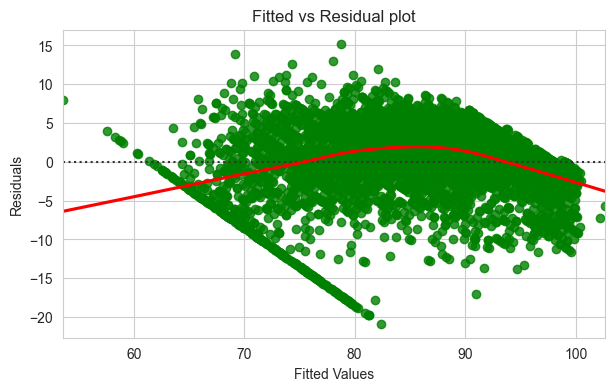

In [124]:
# Plotting fitted values vs residuals
plt.figure(figsize=(7,4))
sns.set_style("whitegrid")
sns.residplot(
    data=df_pred, x="Fitted Values", y="Residuals", color="green", lowess=True, line_kws=dict(color='r')
)
plt.xlabel("Fitted Values")
plt.ylabel("Residuals")
plt.title("Fitted vs Residual plot")
plt.show()

In [125]:
### Checking where the non-linearity is coming from with the help of pairplot

In [126]:
X_train26=X_train25.drop('const',axis=1)

In [127]:
X_train26['usr']=df.usr

In [128]:
X_train26.head()

,lread,scall,swrite,exec,rchar,wchar,pgout,atch,ppgin,pflt,runqsz,freemem,freeswap,usr
1310,26.0,5731.0,224.0,0.80,155004.0,230625.875,0.0,1.5,0.20,48.8,1.0,249.0,1383946.0,81.0
7365,15.0,1203.0,34.0,1.80,163076.0,33674.000,0.0,0.0,0.00,127.8,1.0,2744.0,1542915.0,93.0
2284,39.0,5213.0,368.0,4.99,435848.0,230625.875,6.0,1.5,17.56,348.1,1.0,236.0,1002172.0,64.0
7076,2.0,2585.0,145.0,0.60,329604.0,126738.000,1.0,0.8,30.46,49.9,0.0,451.0,1057294.0,86.0
3114,2.0,1827.0,88.0,0.20,4487.0,8828.000,0.0,0.0,0.20,17.4,0.0,689.0,1752789.0,94.0


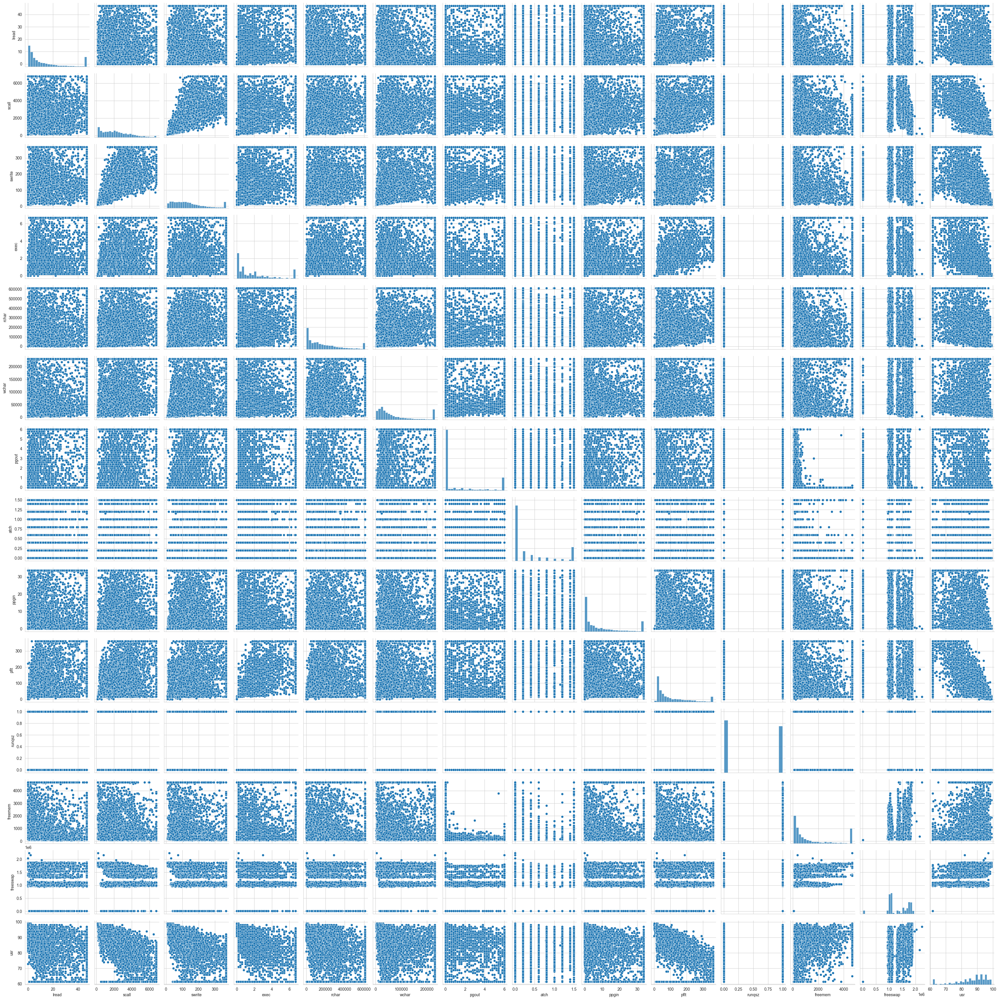

In [129]:
sns.pairplot(X_train26)

In [130]:
### the above pairplot shows some non-linearity coming from 'freemen' variable
### trying to adjust the 'freemem' variable by squaring it

In [131]:
#X_train27=X_train[vif_8.index]

In [132]:
#X_train27.head()

In [133]:
#X_train27['freemem_sq']=(X_train27['freemem'])**2

In [134]:
#olsmod_26=sm.OLS(y_train,X_train27)
#model_26=olsmod_26.fit()
#print(model_26.summary())

### model improved by 0.003 value of R-squared

In [135]:
#vif_9=pd.Series(
#    [variance_inflation_factor(X_train27.values,i) for i in range(X_train27.shape[1])],
#    index=X_train27.columns
#)
#print(f"VIF values: \n\n{vif_9}\n")

In [136]:
#df_pred = pd.DataFrame()

#df_pred["Actual Values"] = y_train.values.flatten()  # actual values
#df_pred["Fitted Values"] = model_26.fittedvalues.values  # predicted values
#df_pred["Residuals"] = model_26.resid.values  # residuals

#df_pred.head()

In [137]:
### reverting to X_train25 version of the ols model_25
olsmod_25=sm.OLS(y_train,X_train25)
model_25=olsmod_25.fit()
print(model_25.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.790
Model:                            OLS   Adj. R-squared:                  0.790
Method:                 Least Squares   F-statistic:                     1659.
Date:                Sat, 23 Sep 2023   Prob (F-statistic):               0.00
Time:                        12:55:35   Log-Likelihood:                -16719.
No. Observations:                5734   AIC:                         3.347e+04
Df Residuals:                    5720   BIC:                         3.356e+04
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         85.1098      0.292    291.503      0.0

In [138]:
### TESTING FOR NORMALITY IN RESIDUALS

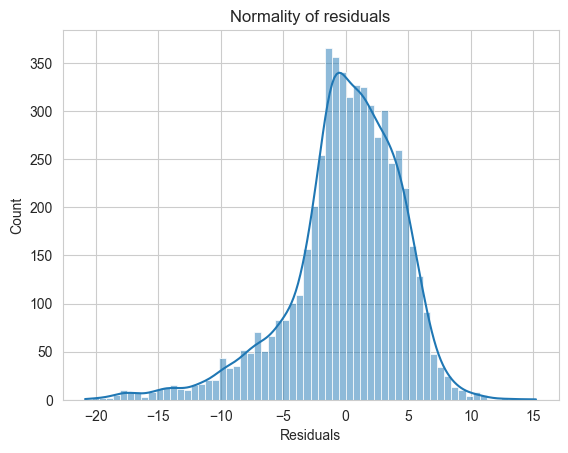

In [139]:
sns.histplot(df_pred["Residuals"], kde=True)
plt.title("Normality of residuals")
plt.show()

In [140]:
# QQ plot to check for normality visually

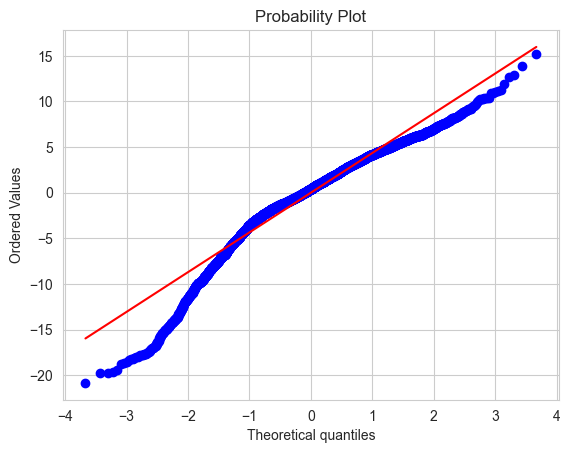

In [141]:
import pylab
import scipy.stats as stats

stats.probplot(df_pred["Residuals"], dist="norm", plot=pylab)
plt.show()

In [142]:
### CHECK FOR HOMOSCEDASTICITY

In [143]:
import statsmodels.stats.api as sms
from statsmodels.compat import lzip

In [144]:
name = ["F statistic", "p-value"]
test = sms.het_goldfeldquandt(df_pred["Residuals"], X_train26)
lzip(name, test)

[('F statistic', 1.0123618916417596), ('p-value', 0.371421012941114)]

In [145]:
### p-value > 0.05 fails to reject the null hypothesis that the residuals are homoscedastic 

##### ---> All assumptions of the linear regression are satisfied (estimate).

In [146]:
### FINAL MODEL
print(model_25.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.790
Model:                            OLS   Adj. R-squared:                  0.790
Method:                 Least Squares   F-statistic:                     1659.
Date:                Sat, 23 Sep 2023   Prob (F-statistic):               0.00
Time:                        12:55:37   Log-Likelihood:                -16719.
No. Observations:                5734   AIC:                         3.347e+04
Df Residuals:                    5720   BIC:                         3.356e+04
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         85.1098      0.292    291.503      0.0

#### 1.4 Inference: Basis on these predictions, what are the business insights and recommendations.
#### Please explain and summarise the various steps performed in this project. There should be proper business interpretation and actionable insights present. - 5 marks

In [147]:
# checking the parameters of the model
model_25.params

const       85.109834
lread       -0.038355
scall       -0.000680
swrite      -0.005168
exec        -0.317918
rchar       -0.000005
wchar       -0.000004
pgout       -0.336280
atch         0.551092
ppgin       -0.059908
pflt        -0.041373
runqsz      -1.747477
freemem     -0.000487
freeswap     0.000009
dtype: float64

In [148]:
### Final equation of linear regression
Equation = "usr ="
print(Equation, end=" ")
for i in range(len(X_train25.columns)):
    if i == 0:
        print(model.params[i], "+", end=" ")
    elif i != len(X_train25.columns) - 1:
        print(
            model_25.params[i],
            "* (",
            X_train25.columns[i],
            ")",
            "+",
            end="  ",
        )
    else:
        print(model_25.params[i], "* (", X_train25.columns[i], ")")

usr = 85.0493905502606 + -0.038355148624787956 * ( lread ) +  -0.0006796180899208 * ( scall ) +  -0.00516827790480312 * ( swrite ) +  -0.31791824161693133 * ( exec ) +  -4.734426806664307e-06 * ( rchar ) +  -4.410733409483615e-06 * ( wchar ) +  -0.3362796067741809 * ( pgout ) +  0.551091802085945 * ( atch ) +  -0.05990782621159879 * ( ppgin ) +  -0.04137305160578238 * ( pflt ) +  -1.7474768971194923 * ( runqsz ) +  -0.00048675572982739054 * ( freemem ) +  9.315381320207643e-06 * ( freeswap )


##### Using the model on Test data

In [149]:
X_train25.columns

Index(['const', 'lread', 'scall', 'swrite', 'exec', 'rchar', 'wchar', 'pgout',
       'atch', 'ppgin', 'pflt', 'runqsz', 'freemem', 'freeswap'],
      dtype='object')

In [150]:
X_test.columns

Index(['const', 'lread', 'lwrite', 'scall', 'sread', 'swrite', 'fork', 'exec',
       'rchar', 'wchar', 'pgout', 'ppgout', 'pgfree', 'atch', 'pgin', 'ppgin',
       'pflt', 'vflt', 'runqsz', 'freemem', 'freeswap'],
      dtype='object')

In [151]:
X_test2=X_test.drop(['lwrite','sread','fork','ppgout','pgin','pgfree','vflt'],axis=1)

In [152]:
X_test2.columns

Index(['const', 'lread', 'scall', 'swrite', 'exec', 'rchar', 'wchar', 'pgout',
       'atch', 'ppgin', 'pflt', 'runqsz', 'freemem', 'freeswap'],
      dtype='object')

In [153]:
X_train25.shape[1]

14

In [154]:
X_test2.shape[1]

14

In [155]:
### Making predictions on the test set
y_pred = model_25.predict(X_test2)

In [156]:
### RMSE for train data
rmse1 = np.sqrt(mean_squared_error(y_train, df_pred["Fitted Values"]))
rmse1

4.467337255395476

In [157]:
### RMSE for test data

In [158]:
rmse2 = np.sqrt(mean_squared_error(y_test, y_pred))
rmse2

4.592418700172624

In [159]:
### Mean absolute error for train data
mae1 = mean_absolute_error(y_train, df_pred["Fitted Values"])
mae1

3.3334174102600915

In [160]:
### Mean absolute error for test data
mae2 = mean_absolute_error(y_test, y_pred)
mae2

3.385216843847559

##### Both, the RMSE and MAE values for both train and test data are similar, which ensures that the model is not over-fit

#### 2.1 Data Ingestion: Read the dataset. Do the descriptive statistics and do null value condition check, check for duplicates and outliers and write an inference on it. Perform Univariate and Bivariate Analysis and Multivariate Analysis. - 7 marks

In [161]:
con=pd.read_excel('Contraceptive_method_dataset.xlsx')

In [162]:
con.head()

,Wife_age,Wife_ education,Husband_education,No_of_children_born,Wife_religion,Wife_Working,Husband_Occupation,Standard_of_living_index,Media_exposure,Contraceptive_method_used
0,24.0,Primary,Secondary,3.0,Scientology,No,2,High,Exposed,No
1,45.0,Uneducated,Secondary,10.0,Scientology,No,3,Very High,Exposed,No
2,43.0,Primary,Secondary,7.0,Scientology,No,3,Very High,Exposed,No
3,42.0,Secondary,Primary,9.0,Scientology,No,3,High,Exposed,No
4,36.0,Secondary,Secondary,8.0,Scientology,No,3,Low,Exposed,No


In [163]:
con.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1473 entries, 0 to 1472
Data columns (total 10 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Wife_age                   1402 non-null   float64
 1   Wife_ education            1473 non-null   object 
 2   Husband_education          1473 non-null   object 
 3   No_of_children_born        1452 non-null   float64
 4   Wife_religion              1473 non-null   object 
 5   Wife_Working               1473 non-null   object 
 6   Husband_Occupation         1473 non-null   int64  
 7   Standard_of_living_index   1473 non-null   object 
 8   Media_exposure             1473 non-null   object 
 9   Contraceptive_method_used  1473 non-null   object 
dtypes: float64(2), int64(1), object(7)
memory usage: 115.2+ KB


In [164]:
### convert Husband_Occupation from 'int' to 'object'
con.Husband_Occupation=con.Husband_Occupation.astype('object')

In [165]:
con.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1473 entries, 0 to 1472
Data columns (total 10 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Wife_age                   1402 non-null   float64
 1   Wife_ education            1473 non-null   object 
 2   Husband_education          1473 non-null   object 
 3   No_of_children_born        1452 non-null   float64
 4   Wife_religion              1473 non-null   object 
 5   Wife_Working               1473 non-null   object 
 6   Husband_Occupation         1473 non-null   object 
 7   Standard_of_living_index   1473 non-null   object 
 8   Media_exposure             1473 non-null   object 
 9   Contraceptive_method_used  1473 non-null   object 
dtypes: float64(2), object(8)
memory usage: 115.2+ KB


In [166]:
con.shape

(1473, 10)

In [167]:
con.isnull().sum()

### Wife_age and No_of_children_born have null values

Wife_age                     71
Wife_ education               0
Husband_education             0
No_of_children_born          21
Wife_religion                 0
Wife_Working                  0
Husband_Occupation            0
Standard_of_living_index      0
Media_exposure                0
Contraceptive_method_used     0
dtype: int64

In [168]:
con.duplicated().sum()

80

In [169]:
### dropping duplicates
con.drop_duplicates(inplace=True)

In [170]:
con.duplicated().sum()

0

In [171]:
con.isnull().sum()

Wife_age                     67
Wife_ education               0
Husband_education             0
No_of_children_born          21
Wife_religion                 0
Wife_Working                  0
Husband_Occupation            0
Standard_of_living_index      0
Media_exposure                0
Contraceptive_method_used     0
dtype: int64

##### Univariate Analysis

In [172]:
con.Wife_age.min()

16.0

In [173]:
con.Wife_age.max()

49.0

In [174]:
con.Wife_age.dtype

dtype('float64')

In [175]:
con.No_of_children_born.min()

0.0

In [176]:
con.No_of_children_born.max()

16.0

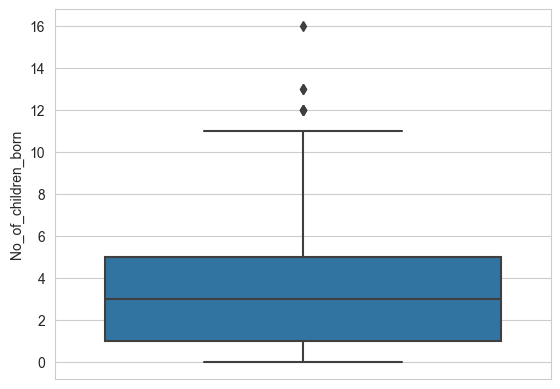

In [177]:
sns.boxplot(data=con,y=con.No_of_children_born);

In [178]:
con.Wife_age.fillna(con.Wife_age.median(),inplace=True)
con.No_of_children_born.fillna(con.No_of_children_born.median(),inplace=True)

In [179]:
con.isnull().sum()

### null values treated with median for both the numerical columns

Wife_age                     0
Wife_ education              0
Husband_education            0
No_of_children_born          0
Wife_religion                0
Wife_Working                 0
Husband_Occupation           0
Standard_of_living_index     0
Media_exposure               0
Contraceptive_method_used    0
dtype: int64

In [180]:
con.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Wife_age,1393.0,NaN,NaN,NaN,32.53051,8.088188,16.0,26.0,32.0,38.0,49.0
Wife_ education,1393,4,Tertiary,515,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Husband_education,1393,4,Tertiary,827,NaN,NaN,NaN,NaN,NaN,NaN,NaN
No_of_children_born,1393.0,NaN,NaN,NaN,3.286432,2.381791,0.0,1.0,3.0,5.0,16.0
Wife_religion,1393,2,Scientology,1186,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Wife_Working,1393,2,No,1043,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Husband_Occupation,1393.0,4.0,3.0,570.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Standard_of_living_index,1393,4,Very High,618,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Media_exposure,1393,2,Exposed,1284,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Contraceptive_method_used,1393,2,Yes,779,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [181]:
for i in range(len(con.columns)):
    if con[con.columns[i]].dtype=='object':
        x=con[con.columns[i]].value_counts()
        print(f"Value counts for {con.columns[i]}:\n{x}\n\n")

Value counts for Wife_ education:
Tertiary      515
Secondary     398
Primary       330
Uneducated    150
Name: Wife_ education, dtype: int64


Value counts for Husband_education:
Tertiary      827
Secondary     347
Primary       175
Uneducated     44
Name: Husband_education, dtype: int64


Value counts for Wife_religion:
Scientology        1186
Non-Scientology     207
Name: Wife_religion, dtype: int64


Value counts for Wife_Working:
No     1043
Yes     350
Name: Wife_Working, dtype: int64


Value counts for Husband_Occupation:
3    570
2    415
1    381
4     27
Name: Husband_Occupation, dtype: int64


Value counts for Standard_of_living_index:
Very High    618
High         419
Low          227
Very Low     129
Name: Standard_of_living_index, dtype: int64


Value counts for Media_exposure :
Exposed        1284
Not-Exposed     109
Name: Media_exposure , dtype: int64


Value counts for Contraceptive_method_used:
Yes    779
No     614
Name: Contraceptive_method_used, dtype: int64




In [182]:
for i in range(len(con.columns)):
    if con[con.columns[i]].dtype=='float64':
        x=con[con.columns[i]].unique()
        print(f"Value counts for {con.columns[i]}:\n{x}\n\n")

Value counts for Wife_age:
[24. 45. 43. 42. 36. 19. 38. 21. 27. 44. 26. 48. 39. 37. 46. 40. 29. 31.
 33. 25. 28. 47. 32. 49. 34. 20. 22. 30. 23. 35. 41. 17. 18. 16.]


Value counts for No_of_children_born:
[ 3. 10.  7.  9.  8.  0.  6.  1.  2.  4.  5. 12. 11. 13. 16.]




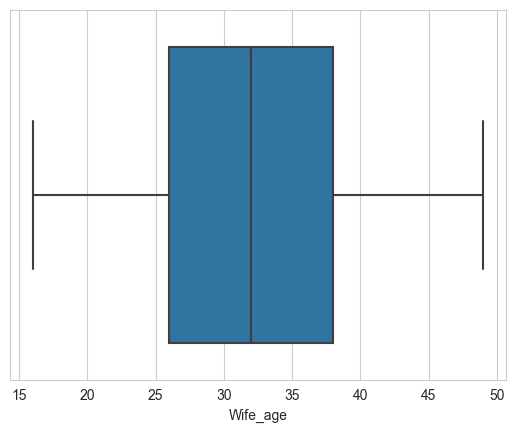

In [183]:
sns.boxplot(data=con,x=con.Wife_age);

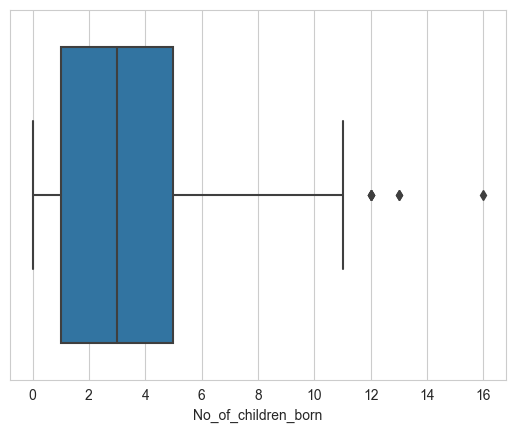

In [184]:
sns.boxplot(data=con,x=con.No_of_children_born);

In [185]:
def remove_outlier(col):
    Q1,Q3=col.quantile([0.25,0.75])
    IQR=Q3-Q1
    upperrange=Q3+(1.5*IQR)
    lowerrange=Q1-(1.5*IQR)
    return upperrange,lowerrange

In [186]:
ur,lr=remove_outlier(con.No_of_children_born)
con.No_of_children_born=np.where(con.No_of_children_born>ur,ur,con.No_of_children_born)

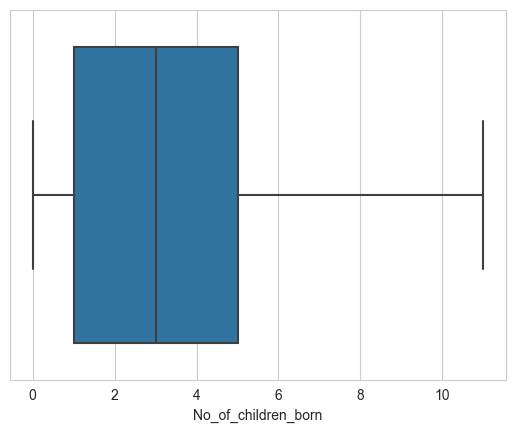

In [187]:
sns.boxplot(data=con,x=con.No_of_children_born);

### outliers treated

In [188]:
con.columns

Index(['Wife_age', 'Wife_ education', 'Husband_education',
       'No_of_children_born', 'Wife_religion', 'Wife_Working',
       'Husband_Occupation', 'Standard_of_living_index', 'Media_exposure ',
       'Contraceptive_method_used'],
      dtype='object')

In [189]:
con.rename(columns={'Wife_ education':'Wife_education'},inplace=True)

In [190]:
con_cat=con.select_dtypes('object')

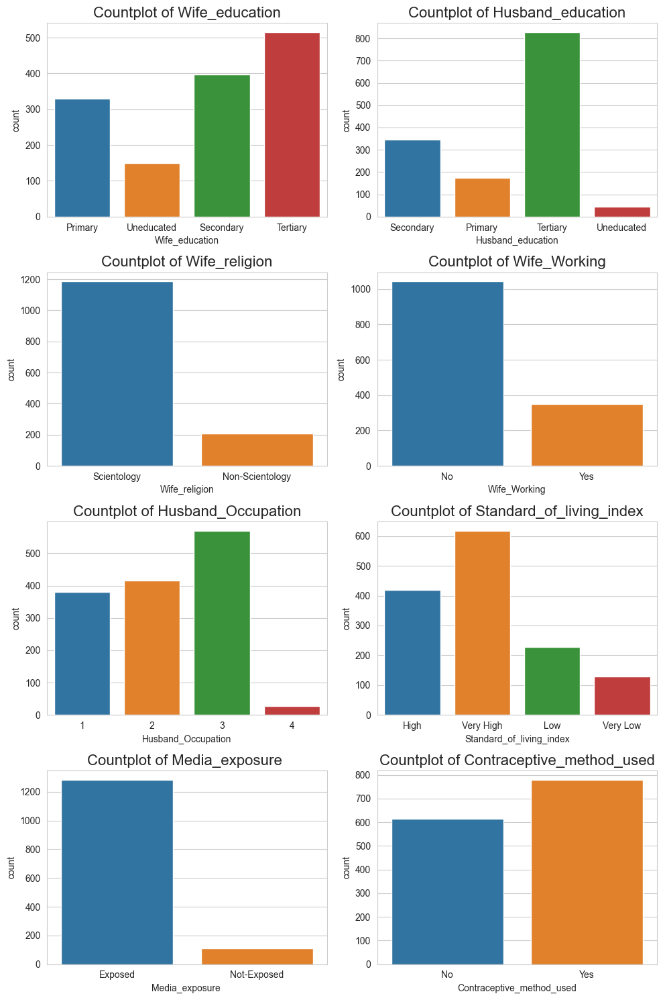

In [191]:
plt.figure(figsize=(10,15))
features=con_cat.columns
for f in range(len(features)):
    plt.subplot(4,2,f+1)
    sns.countplot(data=con_cat,x=con_cat.columns[f])
    plt.title(f"Countplot of {con_cat.columns[f]}",fontsize=16)
    plt.tight_layout();

In [192]:
con.Wife_education.value_counts(normalize=True)

### Majority (estimate: 64%) wives are educated at secondary and tertiary levels

Tertiary      0.369706
Secondary     0.285714
Primary       0.236899
Uneducated    0.107681
Name: Wife_education, dtype: float64

In [193]:
con.Husband_education.value_counts(normalize=True)

### 59% husbands are educated to tertiary level while 24% are educated till secondary level
### when compared to wives in tertiary level education, more husbands are in this tier

Tertiary      0.593683
Secondary     0.249103
Primary       0.125628
Uneducated    0.031587
Name: Husband_education, dtype: float64

In [194]:
### accoridng to the above countplot, majority wives are not working
### majority of the wives belong to scientology religion

In [195]:
con.Husband_Occupation.value_counts(normalize=True)

### Most husbands are working in tier 3 while almost equal proportion of husbands work in 1 and 2 tiers
### the tier 4 of occupation only has about 1.93% of husbands

3    0.409189
2    0.297918
1    0.273510
4    0.019383
Name: Husband_Occupation, dtype: float64

In [196]:
### When it comes to standard of living, majority records belong to 'very high' and 'high' categories

In [197]:
con.Contraceptive_method_used.value_counts(normalize=True)

### 55.92% of the records use contraceptive while the rest 44% don't use contraceptive

Yes    0.559225
No     0.440775
Name: Contraceptive_method_used, dtype: float64

##### Bivariate Analysis

In [198]:
con.columns

Index(['Wife_age', 'Wife_education', 'Husband_education',
       'No_of_children_born', 'Wife_religion', 'Wife_Working',
       'Husband_Occupation', 'Standard_of_living_index', 'Media_exposure ',
       'Contraceptive_method_used'],
      dtype='object')

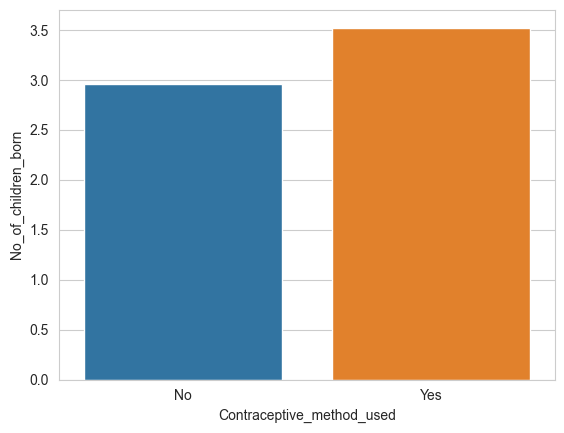

In [199]:
sns.barplot(data=con,y=con.No_of_children_born,x=con.Contraceptive_method_used,ci=False);

### indication of ineffective contraceptives

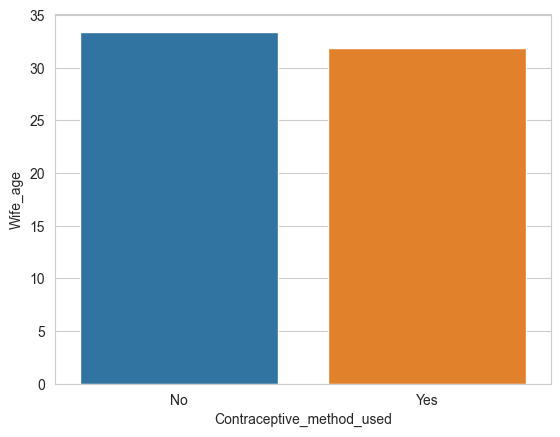

In [200]:
sns.barplot(data=con,y=con.Wife_age,x=con.Contraceptive_method_used,ci=False);

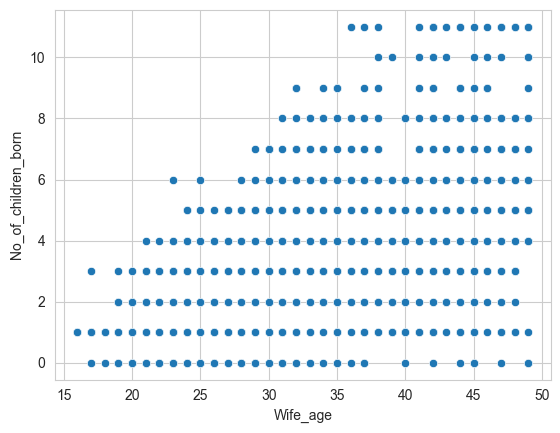

In [201]:
sns.scatterplot(data=con,x=con.Wife_age,y=con.No_of_children_born);

In [202]:
con.corr()

C:\Users\hp\AppData\Local\Temp\ipykernel_13140\1714940404.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  con.corr()


,Wife_age,No_of_children_born
Wife_age,1.000000,0.530123
No_of_children_born,0.530123,1.000000


##### Multivariate Analysis

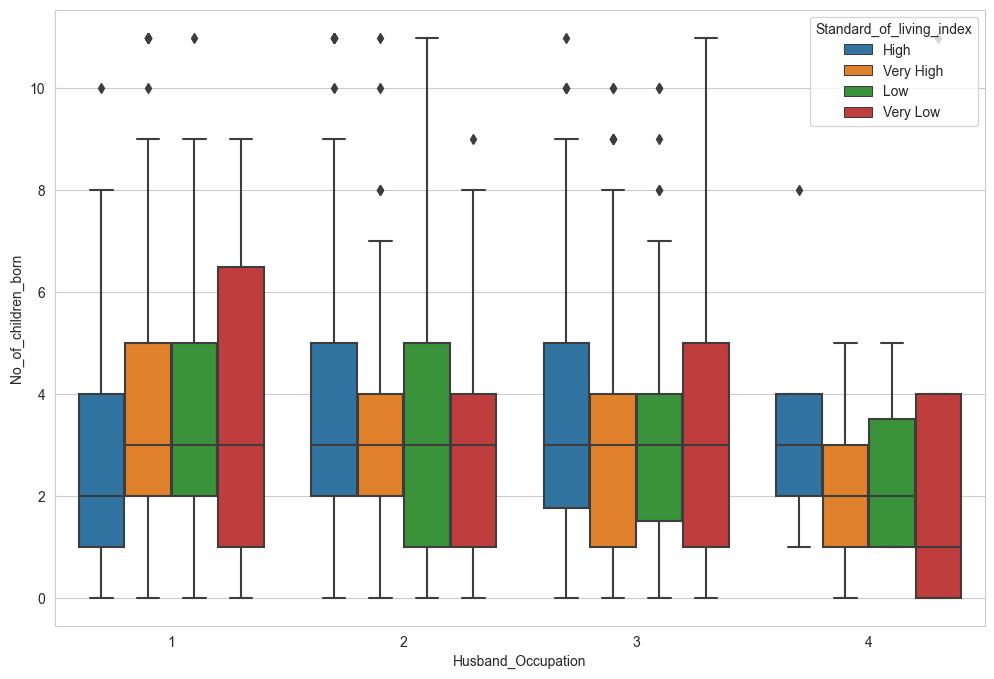

In [203]:
plt.figure(figsize=(12,8))
sns.boxplot(data=con,y=con.No_of_children_born,x=con.Husband_Occupation,hue=con.Standard_of_living_index);

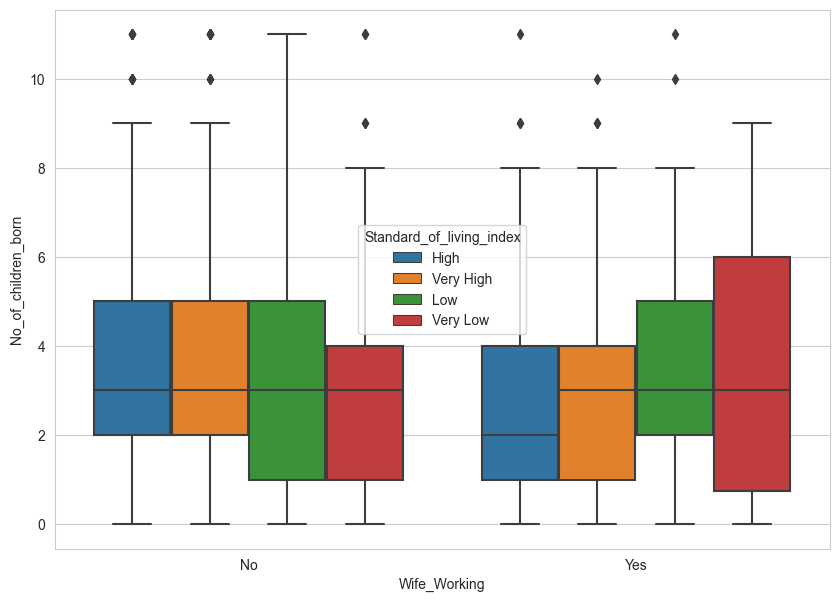

In [204]:
plt.figure(figsize=(10,7))
sns.boxplot(data=con,y=con.No_of_children_born,x=con.Wife_Working,hue=con.Standard_of_living_index);

#### 2.2 Do not scale the data. Encode the data (having string values) for Modelling. Data Split: Split the data into train and test (70:30). Apply Logistic Regression and LDA (linear discriminant analysis) and CART. - 7 marks

In [205]:
from sklearn.linear_model import LogisticRegression

In [206]:
con.Contraceptive_method_used.value_counts(normalize=True)
### the 'class' variable has 55.92% Yes and 44% No values

Yes    0.559225
No     0.440775
Name: Contraceptive_method_used, dtype: float64

In [207]:
con.Wife_education.value_counts()

Tertiary      515
Secondary     398
Primary       330
Uneducated    150
Name: Wife_education, dtype: int64

In [208]:
### converting object variables into numeric

# Wife_education
con.Wife_education=np.where(con.Wife_education=='Uneducated',0,con.Wife_education)
con.Wife_education=np.where(con.Wife_education=='Primary',1,con.Wife_education)
con.Wife_education=np.where(con.Wife_education=='Secondary',2,con.Wife_education)
con.Wife_education=np.where(con.Wife_education=='Tertiary',3,con.Wife_education)

In [209]:
con.Wife_education.value_counts()

3    515
2    398
1    330
0    150
Name: Wife_education, dtype: int64

In [210]:
con.Husband_education.value_counts()

Tertiary      827
Secondary     347
Primary       175
Uneducated     44
Name: Husband_education, dtype: int64

In [211]:
# Husband_education
con.Husband_education=np.where(con.Husband_education=='Uneducated',0,con.Husband_education)
con.Husband_education=np.where(con.Husband_education=='Primary',1,con.Husband_education)
con.Husband_education=np.where(con.Husband_education=='Secondary',2,con.Husband_education)
con.Husband_education=np.where(con.Husband_education=='Tertiary',3,con.Husband_education)

In [212]:
con.Husband_education.value_counts()

3    827
2    347
1    175
0     44
Name: Husband_education, dtype: int64

In [213]:
con.Wife_religion.value_counts()

Scientology        1186
Non-Scientology     207
Name: Wife_religion, dtype: int64

In [214]:
# Wife_religion
con.Wife_religion=np.where(con.Wife_religion=='Scientology',1,con.Wife_religion)
con.Wife_religion=np.where(con.Wife_religion=='Non-Scientology',0,con.Wife_religion)

In [215]:
con.Wife_religion.value_counts()

1    1186
0     207
Name: Wife_religion, dtype: int64

In [216]:
con.Wife_Working.value_counts()

No     1043
Yes     350
Name: Wife_Working, dtype: int64

In [217]:
# Wife_Working
con.Wife_Working=np.where(con.Wife_Working=='Yes',1,con.Wife_Working)
con.Wife_Working=np.where(con.Wife_Working=='No',0,con.Wife_Working)

In [218]:
con.Wife_Working.value_counts()

0    1043
1     350
Name: Wife_Working, dtype: int64

In [219]:
con.Husband_Occupation.value_counts()

# already numeric

3    570
2    415
1    381
4     27
Name: Husband_Occupation, dtype: int64

In [220]:
con.Standard_of_living_index.value_counts()

Very High    618
High         419
Low          227
Very Low     129
Name: Standard_of_living_index, dtype: int64

In [221]:
# Standard_of_living_index
con.Standard_of_living_index=np.where(con.Standard_of_living_index=='Very Low',0,con.Standard_of_living_index)
con.Standard_of_living_index=np.where(con.Standard_of_living_index=='Low',1,con.Standard_of_living_index)
con.Standard_of_living_index=np.where(con.Standard_of_living_index=='High',2,con.Standard_of_living_index)
con.Standard_of_living_index=np.where(con.Standard_of_living_index=='Very High',3,con.Standard_of_living_index)

In [222]:
con.Standard_of_living_index.value_counts()

3    618
2    419
1    227
0    129
Name: Standard_of_living_index, dtype: int64

In [223]:
con.rename(columns={'Media_exposure ': 'Media_exposure'},inplace=True)

In [224]:
con.Media_exposure.value_counts()

Exposed        1284
Not-Exposed     109
Name: Media_exposure, dtype: int64

In [225]:
# Media_exposure
con.Media_exposure=np.where(con.Media_exposure=='Exposed',1,con.Media_exposure)
con.Media_exposure=np.where(con.Media_exposure=='Not-Exposed',0,con.Media_exposure)

In [226]:
con.Media_exposure.value_counts()

1    1284
0     109
Name: Media_exposure, dtype: int64

In [227]:
con.Contraceptive_method_used.value_counts()

Yes    779
No     614
Name: Contraceptive_method_used, dtype: int64

In [228]:
# Contraceptive_method_used
con.Contraceptive_method_used=np.where(con.Contraceptive_method_used=='No',1,con.Contraceptive_method_used)
con.Contraceptive_method_used=np.where(con.Contraceptive_method_used=='Yes',0,con.Contraceptive_method_used)

## NOTE: Everywhere, we have reserved 0 for 'No' and 1 for 'Yes'
## But for dependent variable, we have kept 1 for 'No' since this is what we're interested in
## Note for personal reference

In [229]:
con.Contraceptive_method_used.value_counts()

0    779
1    614
Name: Contraceptive_method_used, dtype: int64

### 1. Logistic Regression

In [230]:
for a in con.columns:
    if con[a].dtype=='object':
        con[a]=con[a].astype('int64')

In [231]:
con.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1393 entries, 0 to 1472
Data columns (total 10 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Wife_age                   1393 non-null   float64
 1   Wife_education             1393 non-null   int64  
 2   Husband_education          1393 non-null   int64  
 3   No_of_children_born        1393 non-null   float64
 4   Wife_religion              1393 non-null   int64  
 5   Wife_Working               1393 non-null   int64  
 6   Husband_Occupation         1393 non-null   int64  
 7   Standard_of_living_index   1393 non-null   int64  
 8   Media_exposure             1393 non-null   int64  
 9   Contraceptive_method_used  1393 non-null   int64  
dtypes: float64(2), int64(8)
memory usage: 119.7 KB


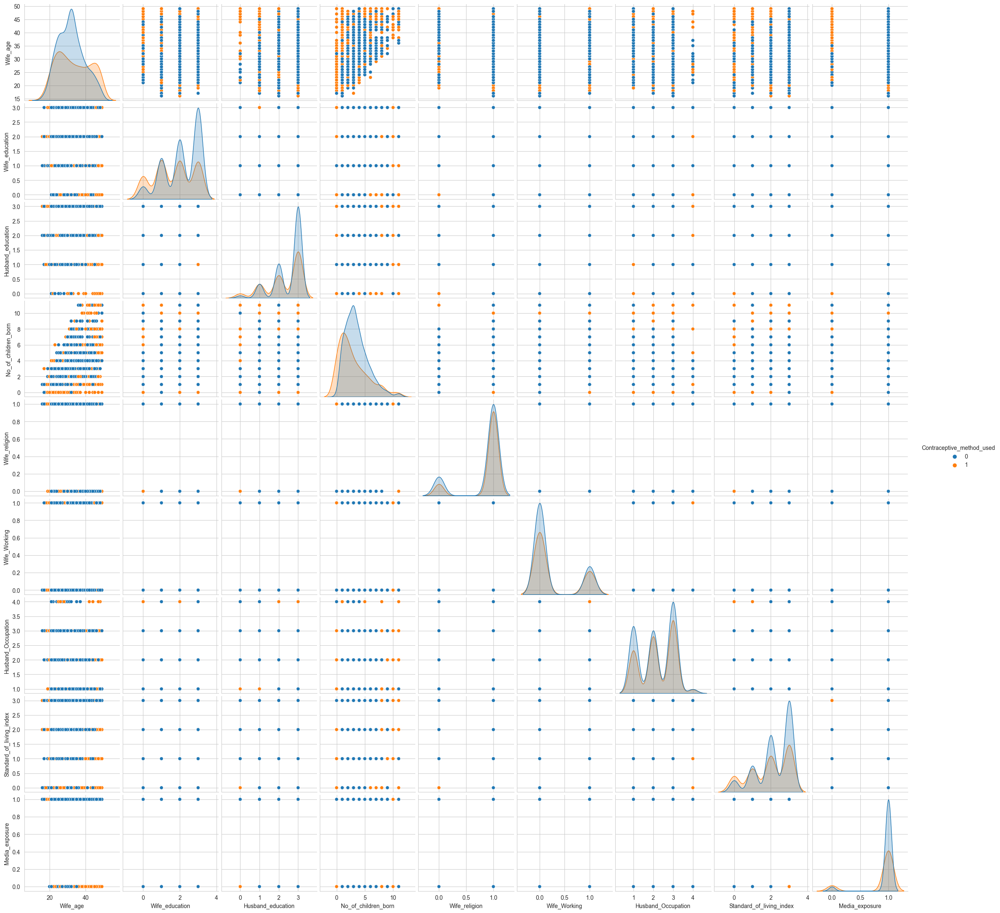

In [232]:
# pairplot of the dataset

sns.pairplot(con,hue='Contraceptive_method_used',diag_kind='kde');

In [233]:
### in the above pairplot, we either have weak predictors or poor predictors as the overlap area between variables
### is significantly large (diagonal), which indicates that they are not splitting the target variable well

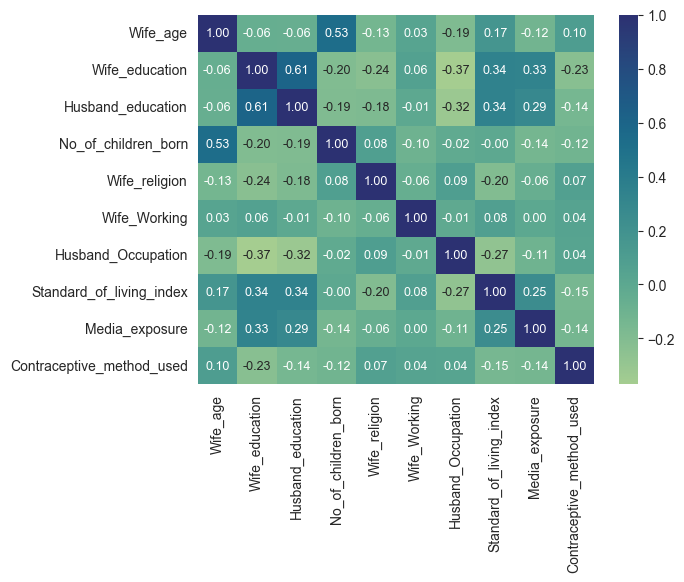

In [234]:
sns.heatmap(con.corr(),cmap='crest',annot=True,fmt='.2f',annot_kws={'size':9});
### checking the impact of independent variables on each other

In [235]:
X=con.drop(['Contraceptive_method_used'],axis=1)
y=con.Contraceptive_method_used

In [236]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.30, random_state=42)

In [237]:
X_train.head()

,Wife_age,Wife_education,Husband_education,No_of_children_born,Wife_religion,Wife_Working,Husband_Occupation,Standard_of_living_index,Media_exposure
1265,35.0,1,3,4.0,0,0,3,1,1
850,33.0,1,1,2.0,1,0,3,3,1
791,31.0,2,3,5.0,1,0,3,0,1
294,29.0,3,3,1.0,1,0,1,2,1
289,35.0,0,2,0.0,1,0,2,1,0


In [238]:
y_train.head()

1265    0
850     0
791     0
294     1
289     1
Name: Contraceptive_method_used, dtype: int64

In [239]:
import warnings
warnings.filterwarnings("ignore")

In [240]:
model_logit=LogisticRegression()
model_logit.fit(X_train,y_train)

LogisticRegression()

In [241]:
from sklearn.metrics import confusion_matrix,classification_report

In [242]:
ytrain_predict_logit=model_logit.predict(X_train)
model_score=model_logit.score(X_train,y_train)
print(model_score)
print(confusion_matrix(y_train,ytrain_predict_logit))
print(classification_report(y_train,ytrain_predict_logit))

0.6646153846153846
[[435 112]
 [215 213]]
              precision    recall  f1-score   support

           0       0.67      0.80      0.73       547
           1       0.66      0.50      0.57       428

    accuracy                           0.66       975
   macro avg       0.66      0.65      0.65       975
weighted avg       0.66      0.66      0.66       975



In [243]:
ytest_predict_logit=model_logit.predict(X_test)
model_score=model_logit.score(X_test,y_test)
print(model_score)
print(confusion_matrix(y_test,ytest_predict_logit))
print(classification_report(y_test,ytest_predict_logit))

0.6770334928229665
[[198  34]
 [101  85]]
              precision    recall  f1-score   support

           0       0.66      0.85      0.75       232
           1       0.71      0.46      0.56       186

    accuracy                           0.68       418
   macro avg       0.69      0.66      0.65       418
weighted avg       0.69      0.68      0.66       418



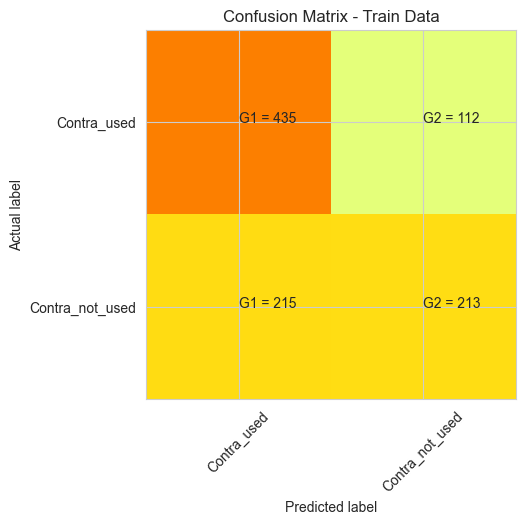

In [244]:
### confusion matrix for train set - logit - we are interested in true negative
cm = confusion_matrix(y_train, ytrain_predict_logit)
plt.clf()
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Wistia)
class_names = ['Contra_used', 'Contra_not_used']
plt.title('Confusion Matrix - Train Data')
plt.ylabel('Actual label')
plt.xlabel('Predicted label')
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names, rotation=45)
plt.yticks(tick_marks, class_names)
s = [['G1', 'G2'], ['G1','G2']]
 
for i in range(2):
    for j in range(2):
        plt.text(j,i, str(s[i][j])+" = "+str(cm[i][j]))

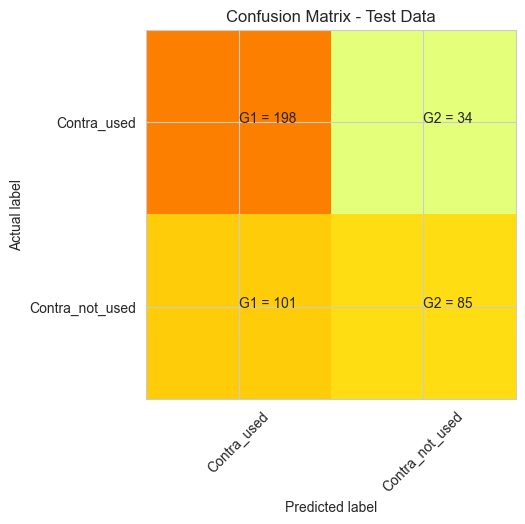

In [245]:
### confusion matrix for test set - logit - we are interested in true negative
cm = confusion_matrix(y_test, ytest_predict_logit)
plt.clf()
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Wistia)
class_names = ['Contra_used', 'Contra_not_used']
plt.title('Confusion Matrix - Test Data')
plt.ylabel('Actual label')
plt.xlabel('Predicted label')
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names, rotation=45)
plt.yticks(tick_marks, class_names)
s = [['G1', 'G2'], ['G1','G2']]
 
for i in range(2):
    for j in range(2):
        plt.text(j,i, str(s[i][j])+" = "+str(cm[i][j]))

In [246]:
### this is our logit model with an accuracy score of 0.67 and precision score of 0.71 (for class 1) which is decent

In [247]:
### in the above confusion matrix:
# G1 = 198 is True Positive
# G1 = 101 is False Positive
# G2 = 85 is True Negative
# G2 = 34 is False Negative

In [248]:
model_logit.coef_

array([[ 0.07867066, -0.44697918, -0.14787693, -0.27758321,  0.39656854,
         0.16490436, -0.13464495, -0.19488841, -0.46818363]])

In [249]:
model_logit.intercept_

array([0.04305369])

AUC: 0.701


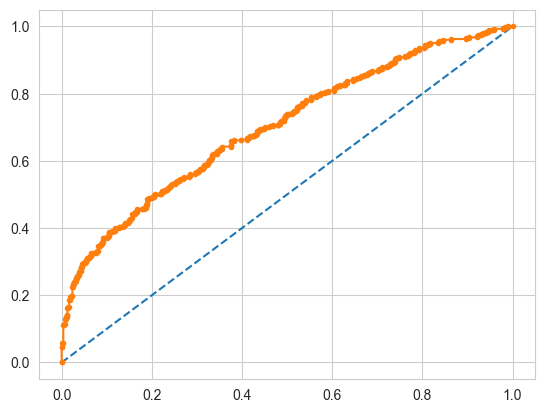

In [250]:
### AUC and ROC for train set - Logit

# predict probabilities
probs = model_logit.predict_proba(X_train)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculating AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_train, probs)
print('AUC: %.3f' % auc)
# calculating ROC curve
from sklearn.metrics import roc_curve
fpr,tpr,thresholds=roc_curve(y_train, probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plotting ROC curve for the model
plt.plot(fpr,tpr,marker='.');

AUC: 0.697


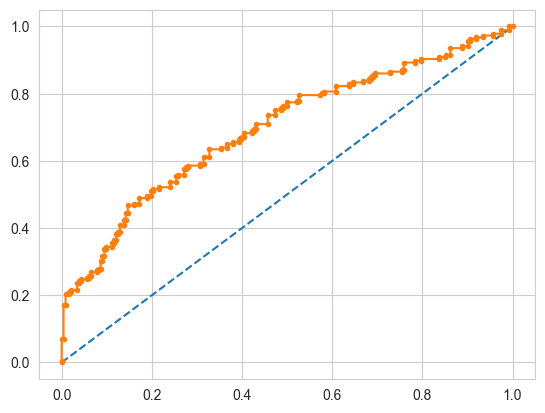

In [251]:
### AUC and ROC for test set - CART

# predict probabilities
probs = model_logit.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculating AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_test, probs)
print('AUC: %.3f' % auc)
# calculating ROC curve
from sklearn.metrics import roc_curve
fpr,tpr,thresholds=roc_curve(y_test, probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plotting ROC curve for the model
plt.plot(fpr,tpr,marker='.');

### 2. LDA

In [252]:
### not scaling the data as mentioned in the instructions
### splitting data
X = con.drop(['Contraceptive_method_used'],axis=1)
Y = con['Contraceptive_method_used']
X_train,X_test,y_train,y_test=train_test_split(X,Y,test_size=.30,random_state=42)

In [253]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
classifier = LinearDiscriminantAnalysis()
classifier.fit(X_train,y_train)
classifier

LinearDiscriminantAnalysis()

In [254]:
Cor1 = X.corr()
Cor1

,Wife_age,Wife_education,Husband_education,No_of_children_born,Wife_religion,Wife_Working,Husband_Occupation,Standard_of_living_index,Media_exposure
Wife_age,1.000000,-0.057025,-0.062177,0.530123,-0.134091,0.032000,-0.187070,0.171420,-0.119737
Wife_education,-0.057025,1.000000,0.606868,-0.195769,-0.236765,0.058523,-0.370799,0.341412,0.334415
Husband_education,-0.062177,0.606868,1.000000,-0.189581,-0.181347,-0.005429,-0.317932,0.342141,0.285320
No_of_children_born,0.530123,-0.195769,-0.189581,1.000000,0.081217,-0.103043,-0.021981,-0.004000,-0.135424
Wife_religion,-0.134091,-0.236765,-0.181347,0.081217,1.000000,-0.055791,0.090034,-0.201524,-0.061603
Wife_Working,0.032000,0.058523,-0.005429,-0.103043,-0.055791,1.000000,-0.013669,0.078367,0.002385
Husband_Occupation,-0.187070,-0.370799,-0.317932,-0.021981,0.090034,-0.013669,1.000000,-0.270934,-0.106340
Standard_of_living_index,0.171420,0.341412,0.342141,-0.004000,-0.201524,0.078367,-0.270934,1.000000,0.245634
Media_exposure,-0.119737,0.334415,0.285320,-0.135424,-0.061603,0.002385,-0.106340,0.245634,1.000000


In [255]:
### checked for correlation
### all independent variables have low correlation so it is safe to go ahead

In [256]:
### prediction - train set - LDA
ytrain_predict_lda = classifier.predict(X_train)
clf_score = classifier.score(X_train,y_train)
print(clf_score)
print(classification_report(y_train, ytrain_predict_lda))

0.6646153846153846
              precision    recall  f1-score   support

           0       0.67      0.81      0.73       547
           1       0.66      0.48      0.56       428

    accuracy                           0.66       975
   macro avg       0.66      0.64      0.64       975
weighted avg       0.66      0.66      0.65       975



In [257]:
### prediction - test set - LDA
ytest_predict_lda = classifier.predict(X_test)
clf_score = classifier.score(X_test,y_test)
print(clf_score)
print(classification_report(y_test, ytest_predict_lda))

### model accuracy is low but precision is high in the target class, i.e., 1

0.6650717703349283
              precision    recall  f1-score   support

           0       0.65      0.86      0.74       232
           1       0.71      0.42      0.53       186

    accuracy                           0.67       418
   macro avg       0.68      0.64      0.63       418
weighted avg       0.68      0.67      0.65       418



In [258]:
### confusion matrix - train set - LDA
confusion_matrix(y_train, ytrain_predict_lda)

array([[441, 106],
       [221, 207]], dtype=int64)

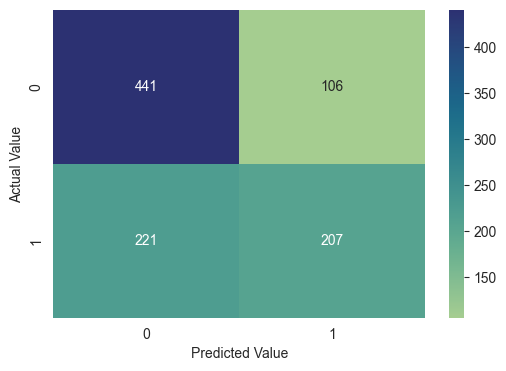

In [259]:
### visualising confusion matrix for train set - LDA
plt.figure(figsize=(6,4))
sns.heatmap(confusion_matrix(y_train, ytrain_predict_lda),annot=True,fmt='.4g',cmap='crest'),'\n\n'
plt.ylabel('Actual Value')
plt.xlabel('Predicted Value');

In [260]:
### confusion matrix - test set - LDA
confusion_matrix(y_test, ytest_predict_lda)

array([[200,  32],
       [108,  78]], dtype=int64)

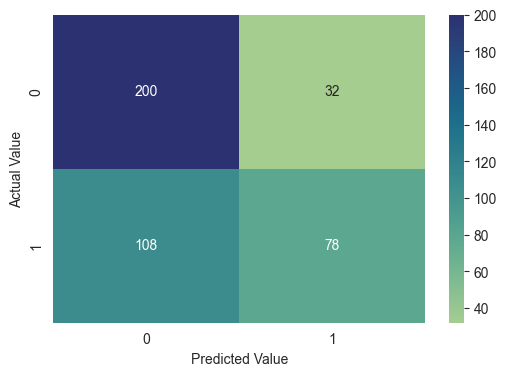

In [261]:
### visualising confusion matrix for test set - LDA
plt.figure(figsize=(6,4))
sns.heatmap(confusion_matrix(y_test, ytest_predict_lda),annot=True,fmt='.4g',cmap='crest'),'\n\n'
plt.ylabel('Actual Value')
plt.xlabel('Predicted Value');

In [262]:
### The LDA model has predicted 110 rows as 1 (target class) and 308 rows as 0

In [263]:
classifier.coef_

array([[ 0.07654536, -0.45425727, -0.14185   , -0.2701374 ,  0.40634349,
         0.16969283, -0.14258824, -0.20261762, -0.48005505]])

In [264]:
classifier.intercept_

array([0.09144935])

In [265]:
'''
LDF=0.091 + X1*0.076 + X2*(-0.454) + X3*(-0.141) + X4*(-0.270) + X5*0.406 + X6*(0.169) + X7*(-0.142) + X8*(-0.202) + X9(-0.480)
'''

'\nLDF=0.091 + X1*0.076 + X2*(-0.454) + X3*(-0.141) + X4*(-0.270) + X5*0.406 + X6*(0.169) + X7*(-0.142) + X8*(-0.202) + X9(-0.480)\n'

In [266]:
### X9 and X2 has the most discriminating power towards the class variable, since its coefficient has the highest magnitude
### The least descriminating power is coming from X1 since it has the lowest magnitude

AUC: 0.701


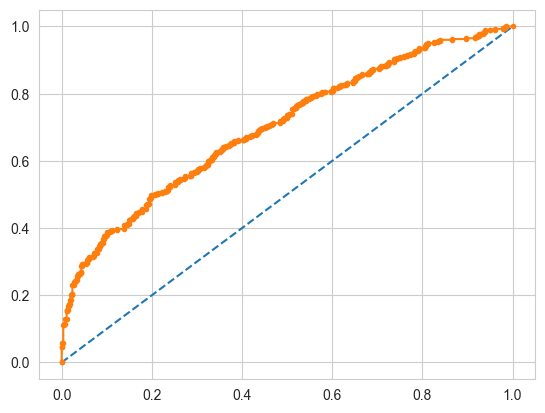

In [267]:
### AUC and ROC for test set - LDA

# predict probabilities
probs = classifier.predict_proba(X_train)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculating AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_train, probs)
print('AUC: %.3f' % auc)
# calculating ROC curve
from sklearn.metrics import roc_curve
fpr,tpr,thresholds=roc_curve(y_train, probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plotting ROC curve for the model
plt.plot(fpr,tpr,marker='.');

AUC: 0.697


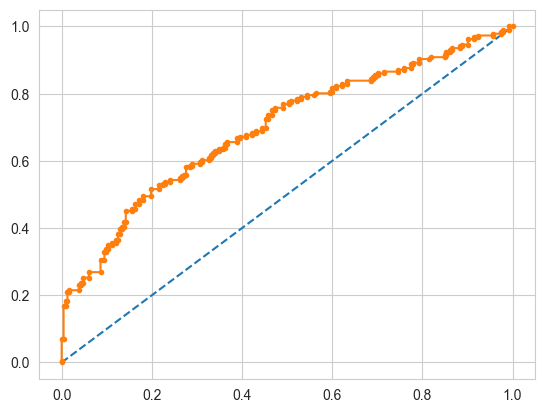

In [268]:
### AUC and ROC for test set - LDA

# predict probabilities
probs = classifier.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculating AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_test, probs)
print('AUC: %.3f' % auc)
# calculating ROC curve
from sklearn.metrics import roc_curve
fpr,tpr,thresholds=roc_curve(y_test, probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plotting ROC curve for the model
plt.plot(fpr,tpr,marker='.');

### 3. CART

In [269]:
from sklearn import tree
from sklearn.tree import DecisionTreeClassifier

In [270]:
### creating decision tree model
model_dt=DecisionTreeClassifier(criterion='gini')
model_dt.fit(X_train, y_train)

DecisionTreeClassifier()

In [271]:
### creating decision tree file for graphviz implementation
train_char_label = ['No', 'Yes']
Contra_Tree_File = open('Contra_tree.dot','w')
dot_data=tree.export_graphviz(model_dt,out_file=Contra_Tree_File,feature_names=list(X_train),class_names=list(train_char_label))

Contra_Tree_File.close()

In [272]:
print(pd.DataFrame(model_dt.feature_importances_,columns=["Gini_Imp"],index=X_train.columns))

### below is the gini importance for each feature
### this parameter tells us how much each feature has been used in splitting the dependent variable
### the below figures are normalized

                          Gini_Imp
Wife_age                  0.308261
Wife_education            0.110920
Husband_education         0.073578
No_of_children_born       0.252012
Wife_religion             0.033839
Wife_Working              0.047048
Husband_Occupation        0.073141
Standard_of_living_index  0.084163
Media_exposure            0.017038


In [273]:
### checking the decision tree model via graphviz to see how we can regularize the model

In [274]:
model_dt_reg=DecisionTreeClassifier(criterion='gini',max_depth=9,min_samples_leaf=10,min_samples_split=30)
model_dt_reg.fit(X_train,y_train)

DecisionTreeClassifier(max_depth=9, min_samples_leaf=10, min_samples_split=30)

In [275]:
train_char_label=['No','Yes']
Contra_Tree_File=open('Contra_Tree_Reg.dot','w')
dot_data_reg=tree.export_graphviz(model_dt_reg,out_file=Contra_Tree_File,feature_names=list(X_train),class_names=list(train_char_label))

Contra_Tree_File.close()

In [276]:
print(pd.DataFrame(model_dt_reg.feature_importances_,columns=["Gini Imp"],index=X_train.columns))

                          Gini Imp
Wife_age                  0.323388
Wife_education            0.154638
Husband_education         0.029856
No_of_children_born       0.396749
Wife_religion             0.007844
Wife_Working              0.002985
Husband_Occupation        0.039359
Standard_of_living_index  0.045180
Media_exposure            0.000000


In [277]:
### the feature importance of No_of_children_born, Wife_age, and Wife_education are the 
### if the gini importance of any variable is 0, it suggests that this particular variable was not used
# in splitting the class variable, hence, it can be dropped

### above, we can see that Media_exposure feature was not used in classification
### Wife_working and Wife_religion do not seem to have much effect on 'contraceptive_method_used' as well

In [278]:
ytrain_predict_dt = model_dt_reg.predict(X_train)
ytest_predict_dt = model_dt_reg.predict(X_test)

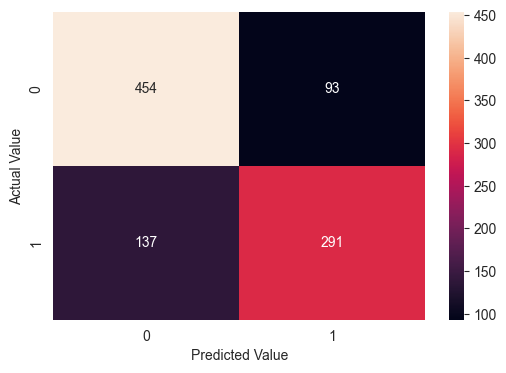

In [279]:
plt.figure(figsize=(6,4))
sns.heatmap(confusion_matrix(y_train, ytrain_predict_dt),annot=True,fmt='.4g'),'\n\n'
plt.ylabel('Actual Value')
plt.xlabel('Predicted Value');

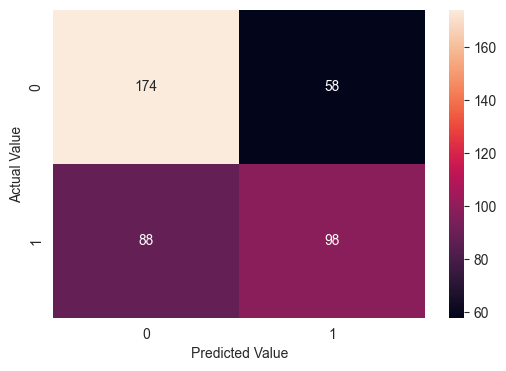

In [280]:
plt.figure(figsize=(6,4))
sns.heatmap(confusion_matrix(y_test, ytest_predict_dt),annot=True,fmt='.4g'),'\n\n'
plt.ylabel('Actual Value')
plt.xlabel('Predicted Value');

AUC: 0.838


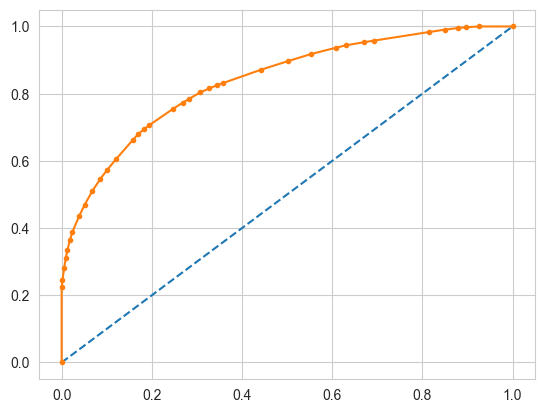

In [281]:
### AUC and ROC for training set - CART

# predict probabilities
probs = model_dt_reg.predict_proba(X_train)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculating AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_train, probs)
print('AUC: %.3f' % auc)
# calculating ROC curve
from sklearn.metrics import roc_curve
fpr,tpr,thresholds=roc_curve(y_train, probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plotting ROC curve for the model
plt.plot(fpr,tpr,marker='.');

AUC: 0.722


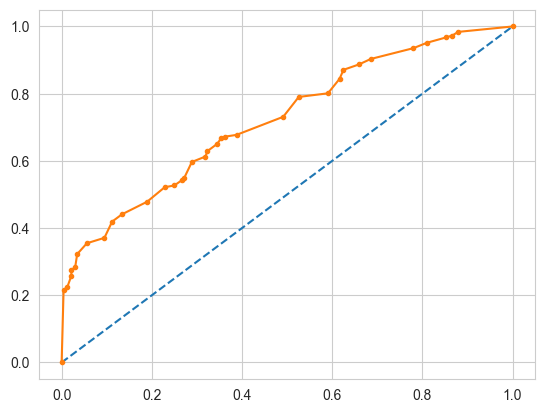

In [282]:
### AUC and ROC for test set - CART

# predict probabilities
probs = model_dt_reg.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculating AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_test, probs)
print('AUC: %.3f' % auc)
# calculating ROC curve
from sklearn.metrics import roc_curve
fpr,tpr,thresholds=roc_curve(y_test, probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plotting ROC curve for the model
plt.plot(fpr,tpr,marker='.');

In [283]:
print(model_dt_reg.score(X_train,y_train))
print(classification_report(y_train,ytrain_predict_dt))

0.764102564102564
              precision    recall  f1-score   support

           0       0.77      0.83      0.80       547
           1       0.76      0.68      0.72       428

    accuracy                           0.76       975
   macro avg       0.76      0.75      0.76       975
weighted avg       0.76      0.76      0.76       975



In [284]:
print(model_dt_reg.score(X_test,y_test))
print(classification_report(y_test,ytest_predict_dt))

0.6507177033492823
              precision    recall  f1-score   support

           0       0.66      0.75      0.70       232
           1       0.63      0.53      0.57       186

    accuracy                           0.65       418
   macro avg       0.65      0.64      0.64       418
weighted avg       0.65      0.65      0.65       418



#### 2.3 Performance Metrics: Check the performance of Predictions on Train and Test sets using Accuracy, Confusion Matrix, Plot ROC curve and get ROC_AUC score for each model Final Model: Compare Both the models and write inference which model is best/optimized. - 6 marks

In [285]:
### in the report

#### 2.4 Inference: Basis on these predictions, what are the insights and recommendations.
#### Please explain and summarise the various steps performed in this project. There should be proper business interpretation and actionable insights present. - 4 marks

### In the report


The model for LOGIT and LDA on training data has the same accuracy score of 0.0.6646. However, LOGIT performed better on test data with the accuracy score of 0.677 against that of CART, i.e., 0.665. One point to be noted is that there was a slight increase the accuracy score of LDA models from train to test set.

The CART train data set accuracy score was 0.764 but dropped to 0.65 for the test data set, which is the biggest drop of all three models.

The test data precision score for class 1 for both LOGIT and LDA is 0.71, while for CART it is 0.63.

Logit was able to make 283 correct predictions, LDA made 278 correct predictions, while CART made 272 correct predictions. I would go with the Logistic Regression model to make predictions.